In [1]:
%load_ext autoreload
%autoreload 2
%reset -f
from custom_imports import *

/home/bzr0014/anaconda3/envs/tensorGpu2/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:458: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/home/bzr0014/anaconda3/envs/tensorGpu2/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:459: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/home/bzr0014/anaconda3/envs/tensorGpu2/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:460: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/home/bzr0014/anaconda3/envs/te

In [2]:
tf.test.is_gpu_available()

False

In [2]:
#client = Client(scheduler_file='/home/bzr0014/schedfile')
#client = Client(cluster)
#client.restart()

In [3]:
dsize = resize_width, resize_height = 300, 300
neighSize = 41
STEP = 2

# Step 1 preparing input

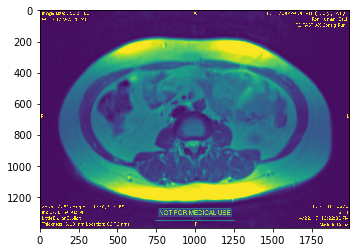

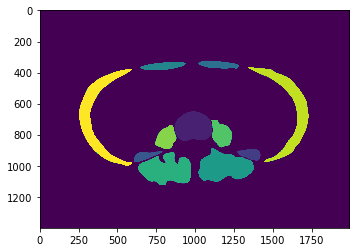

In [4]:
%reset_selective -f  .*(?<!_)$
from custom_imports import *
XY = joblib.load('classified_and_raw_11muscles_v02.pkl')
n = np.random.randint(len(XY))
plt.imshow(XY[n][1])
plt.show()
plt.imshow(XY[n][2])

In [5]:
img_indx = np.random.randint(len(XY))
scnd_img_to_drw = get_torso_outline(XY[img_indx][1:])
if scnd_img_to_drw is None:
    print("is None")
else:
    plt.imshow(scnd_img_to_drw)

((1400, 1991), (1400, 1991))
is None


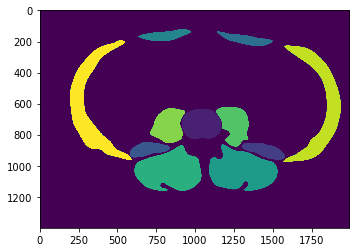

In [6]:
plt.imshow(XY[img_indx][2])

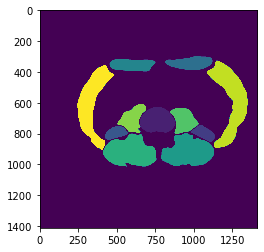

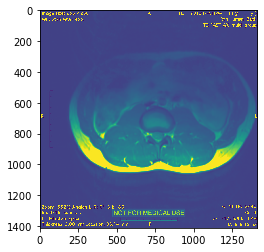

In [33]:
plt.imshow(XY[img_indx][2])
plt.show()
plt.imshow(XY[img_indx][1])
plt.show()
if scnd_img_to_drw is not None:
    plt.imshow(scnd_img_to_drw)

In [17]:
%reset_selective -f  .*(?<!_)$
%who_ls

[]

In [1]:
try:
    pool.close()
except NameError:
    pass
%reset_selective -f  .*(?<!_)$
from custom_imports import *
pool = Pool(50)
XY = joblib.load('classified_and_raw_11muscles_v02.pkl')
print(len(XY))

/home/bzr0014/anaconda3/envs/tensorGpu2/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:458: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/home/bzr0014/anaconda3/envs/tensorGpu2/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:459: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/home/bzr0014/anaconda3/envs/tensorGpu2/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:460: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/home/bzr0014/anaconda3/envs/te

241
12

((1393, 1981), (1393, 1981))
((1400, 1991), (1400, 1991))
((1393, 1981), (1393, 1981))
((1400, 1991), (1400, 1991))
((1400, 1991), (1400, 1991))
((1400, 1991), (1400, 1991))
((1400, 1991), (1400, 1991))
((1400, 1991), (1400, 1991))
((1400, 1991), (1400, 1991))
((1400, 1991), (1400, 1991))
((1400, 1991), (1400, 1991))
((1400, 1991), (1400, 1991))
((1400, 1991), (1400, 1991))
((1400, 1991), (1400, 1991))
((1400, 1991), (1400, 1991))
((1400, 1991), (1400, 1991))
((1400, 1991), (1400, 1991))
((1400, 1991), (1400, 1991))
((1400, 1991), (1400, 1991))
((1400, 1991), (1400, 1991))
((1400, 1991), (1400, 1991))
((1400, 1991), (1400, 1991))
((1400, 1991), (1400, 1991))
((1400, 1991), (1400, 1991))
((1400, 1991), (1400, 1991))
((1400, 1991), (1400, 1991))
((1400, 1991), (1400, 1991))
((1404, 1996), (1404, 1996))
((1400, 1991), (1400, 1991))
((1404, 1996), (1404, 1996))
((1404, 1996), (1404, 1996))
((1404, 1996), (1404, 1996))
((1400, 1991), (1400, 1991))
((1400, 1991), (1400, 1991))
((1400

In [2]:
pool.map(print, [1, 2])

[None, None]

In [3]:
dsize = resize_width, resize_height = 300, 300
neighSize = 41
STEP = 2

In [4]:
z = pool.map(get_torso_outline, [x[1:] for x in XY])

In [7]:
rsz_x = [delayed(resize_float)(x[1], dsize) for x in XY]
rsz_y = [delayed(resize_int)(x[2], dsize) for x in XY]
rsz_z = [delayed(resize_int)(x, dsize) for x in z]

In [8]:
with dask.config.set(pool=pool):
    rsz_x, rsz_y, rsz_z = compute(rsz_x, rsz_y, rsz_z)

In [9]:
with dask.config.set(pool=pool):
    nrmlzd_rszd_x, *_  = compute([delayed(normalize_image)(x) for x in rsz_x])

In [31]:
XYZ = list((xy[0], x, y, z) for xy, x, y, z in zip(XY, nrmlzd_rszd_x, rsz_y, rsz_z) if z is not None)
XYZ_full = list((xy[0], x, y, z) for xy, x, y, z in zip(XY, nrmlzd_rszd_x, rsz_y, rsz_z))

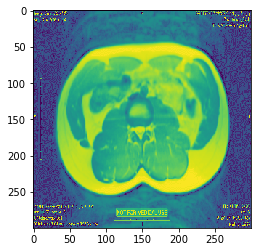

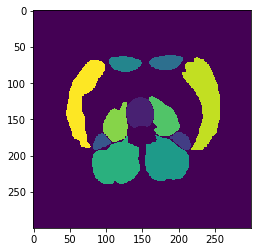

In [32]:
n = np.random.randint(len(XYZ))
plt.imshow(XYZ[n][1])
plt.show()
plt.imshow(XYZ[n][2])

In [33]:
joblib.dump(XYZ, 'XYZ_11muscle_v02_v02.pkl')
joblib.dump(XYZ_full, 'XYZ_11muscle_full_v02.pkl')

['XYZ_11muscle_full_v02.pkl']

# Step 2: Loading Data and running model

## Preparing sampling
At this point, let's just take random samples, in the future I can change this so I can decide what proportion of each label I want to pick; that is, setting a weight for each label.

*It is important to note that in order to make random kernel truly random, we need to explicitly pass the random seed to them. Otherwise the random states for all kernels (i.e. get_sample below) will have the same random states, leading to the same results on different runs.*

In [1]:
%load_ext autoreload
%autoreload 2
%reset_selective -f  .*(?<!_)$
%who_ls
from custom_imports import *
XY = joblib.load('classified_and_raw_11muscles_v02.pkl')
XYZ = joblib.load('XYZ_11muscle_full_v02.pkl')

/home/bzr0014/anaconda3/envs/tensorGpu2/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:458: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/home/bzr0014/anaconda3/envs/tensorGpu2/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:459: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/home/bzr0014/anaconda3/envs/tensorGpu2/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:460: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/home/bzr0014/anaconda3/envs/te

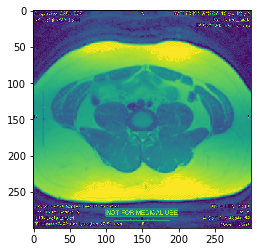

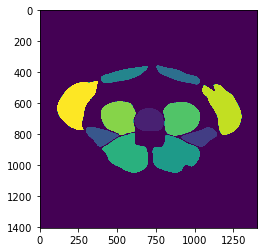

In [2]:
n = np.random.randint(len(XYZ))
plt.imshow(XYZ[n][1])
plt.show()
plt.imshow(XY[n][2])

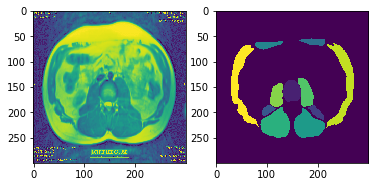

In [3]:
i = np.random.randint(len(XYZ))
fig, axes = plt.subplots(1, 2)
axes = axes.reshape(-1)
for i, x in enumerate(XYZ[i][1:-1]):
    axes[i].imshow(x)

In [4]:
#def get_neighbors_masked(xyz, neigh_size):
#    m = neigh_size//2
#    print(m)
#    x, y, z= xyz
#    # change later
#    x = (x-x.mean())/x.std()
#    w, h, *_ = x.shape
#    X = []
#    Y = []
#    indices = list(zip(*np.where(z)))
#    for i, j in indices:
#        tmp = x[i-m:i+m, j-m:j+m]
#        if tmp.shape == (2*m, 2*m):
#            X.append(tmp)
#            Y.append(y[i, j])
#    return np.array(X), np.array(Y)

In [5]:
#_XYZ = client.scatter(XYZ)

In [6]:
#from sklearn.preprocessing import OneHotEncoder
#from sklearn.model_selection import train_test_split
#try:
#    mardas, *_ = compute([delayed(get_neighbors_masked)(x, neigh_size=neighSize) for x in _XYZ])
#    X = np.concatenate([x[0] for x in mardas])
#    Y = np.concatenate([x[1] for x in mardas])
#    del mardas
#    encoder = OneHotEncoder()
#    Y = encoder.fit_transform(Y.reshape(-1, 1))
#    X = X.reshape(*X.shape, 1)
#    Xtr, Xts, Ytr, Yts = train_test_split(X, Y, test_size=.2)
#finally:
#    del X
#    del Y

In [2]:
%load_ext autoreload
%autoreload 2
%reset -f
%who_ls
from custom_imports import *
neighSize = 82
step = 2
def get_neighbors(xy, neigh_size, step):
    m = neigh_size//2
    if isinstance(xy, tuple):
        x, y = xy
        N, w, h, *_ = x.shape
        X = []
        Y = []
        for t in range(N):
            for i in range(m, w-m, step):
                for j in range(m, h-m, step):
                    X.append(x[t, i-m:i+m, j-m:j+m])
                    Y.append(y[t, i, j])
        return np.array(X), np.array(Y)
    else:
        x = xy
        N, w, h, *_ = x.shape
        X = []
        for t in range(N):
            for i in range(m, w-m, step):
                for j in range(m, h-m, step):
                    X.append(x[t, i-m:i+m, j-m:j+m])
        return np.array(X)
XY = joblib.load('classified_and_raw_11muscles_v02.pkl')
XYZ = joblib.load('XYZ_11muscle_full_v02.pkl')

/home/bzr0014/anaconda3/envs/tensorGpu2/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:458: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/home/bzr0014/anaconda3/envs/tensorGpu2/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:459: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/home/bzr0014/anaconda3/envs/tensorGpu2/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:460: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/home/bzr0014/anaconda3/envs/te

In [1]:
Y = np.array([x[2] for x in XYZ])
X = np.array([x[1] for x in XYZ])
mu  = X.mean(axis=(1, 2), keepdims=True)
std = X.std(axis=(1, 2), keepdims=True)
X = (X - mu)/std
Xtr, Xts, Ytr, Yts = train_test_split(X, Y, random_state=15)
t = np.array([[i/300, j/300] for i in range(300) for j in range(300)]).reshape(-1, 2)
Xt = np.array([t for i in range(len(Xtr))])
Xtr = np.concatenate([Xtr.reshape(-1, 1), Xt], axis=1)

NameError: name 'np' is not defined

In [4]:
from sklearn.ensemble import RandomForestClassifier

In [5]:
model = RandomForestClassifier(n_estimators=300, n_jobs=100)

In [6]:
Xtr.shape[0]/Xts.shape[0]

265573.7704918033

In [7]:
model.fit(Xtr, Ytr.reshape(-1))

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=300,
                       n_jobs=100, oob_score=False, random_state=None,
                       verbose=0, warm_start=False)

48


30


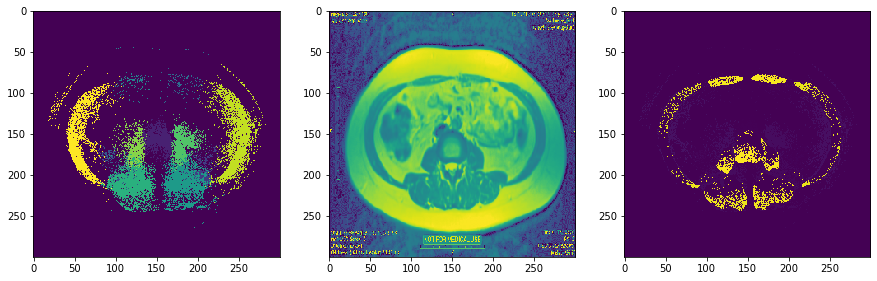

In [90]:
n = np.random.randint(Xts.shape[0])
print(n)
x_in = np.concatenate([Xts[n].reshape(-1, 1), t], axis=1)
ypred = model.predict(x_in).reshape(300, 300)
fig, axes = plt.subplots(1, 3, figsize=(15, 5))
axes[0].imshow(ypred)
axes[1].imshow(Xts[n])
axes[2].imshow(ypred-Yts[n])

In [3]:
%load_ext autoreload
%autoreload 2
%reset -f
%who_ls
from custom_imports import *
neighSize = 82
step = 2
def get_neighbors(xy, neigh_size, step):
    m = neigh_size//2
    if isinstance(xy, tuple):
        x, y = xy
        N, w, h, *_ = x.shape
        X = []
        Y = []
        for t in range(N):
            for i in range(m, w-m, step):
                for j in range(m, h-m, step):
                    X.append(x[t, i-m:i+m, j-m:j+m])
                    Y.append(y[t, i, j])
        return np.array(X), np.array(Y)
    else:
        x = xy
        N, w, h, *_ = x.shape
        X = []
        for t in range(N):
            for i in range(m, w-m, step):
                for j in range(m, h-m, step):
                    X.append(x[t, i-m:i+m, j-m:j+m])
        return np.array(X)
XY = joblib.load('classified_and_raw_11muscles_v02.pkl')
XYZ = joblib.load('XYZ_11muscle_full_v02.pkl')

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [4]:
X = np.array([x[1] for x in XYZ])
Y = np.array([x[2] for x in XYZ])
encoder = OneHotEncoder()
mu  = X.mean(axis=(1, 2), keepdims=True)
std = X.std(axis=(1, 2), keepdims=True)
X = (X-mu)/std
Xtr_, Xts, Ytr_, Yts = train_test_split(X, Y, random_state=15)
Xtr, Ytr = get_neighbors((Xtr_, Ytr_), neighSize, step)
Ytr = encoder.fit_transform(Ytr.reshape(-1, 1)).toarray().reshape(*Ytr.shape, -1)
Xtr = Xtr.reshape(*Xtr.shape, 1)
#del XY, XYZ, X, Y, Xtr_, Ytr_

In [5]:
joblib.dump(encoder, '11_muscle_encoder.pkl')

['11_muscle_encoder.pkl']

In [4]:
def gen_neighbors_masked(x, y, neigh_size, z=None, size=1000):
    np.random.seed(random.randint(0, 1000))
    m = neigh_size//2
    c = y.shape[-1]
    if z is None:
        z = np.zeros_like(x)
        z[:, neigh_size:-neigh_size, neigh_size:-neigh_size] = 1
    indices = np.array(np.where(z)).T
    while True:
        rnds = np.random.randint(0, len(indices), size=size)
        X = np.array([x[i, j-m:j+m, k-m:k+m]
                for i, j, k, t in indices[rnds]])
        Y = np.array([y[i, j, k]
                for i, j, k, t in indices[rnds]]).reshape(-1, c)
        yield X, Y

In [5]:
Ytr.shape

(2138580, 12)

In [6]:
#import tensorflow as tf
#from keras import backend as K
#
#num_cores = 70
#GPU = False
#CPU = True
#if GPU:
#    num_GPU = 4
#    num_CPU = 1
#if CPU:
#    num_CPU = 1
#    num_GPU = 0
#    
#config = tf.ConfigProto(intra_op_parallelism_threads=num_cores,
#                        inter_op_parallelism_threads=num_cores, 
#                        allow_soft_placement=True,
#                        device_count = {'CPU' : num_CPU,
#                                        'GPU' : num_GPU}
#                       )
#
#session = tf.Session(config=config)
#K.set_session(session)

# Model v02

In [169]:
# Keras simple deep model:
def build_v02(width, height, depth, reg, init="he_normal"):
    # initialize the model along with the input shape to be
    # "channels last" and the channels dimension itself
    model = Sequential()
    inputShape = (height, width, depth)
    chanDim = -1

    # if we are using "channels first", update the input shape
    # and channels dimension
    if K.image_data_format() == "channels_first":
        inputShape = (depth, height, width)
        chanDim = 1
        
    # our first CONV layer will learn a total of 16 filters, each
    # Of which are 7x7 -- we'll then apply 2x2 strides to reduce
    # the spatial dimensions of the volume
    #model.add(Conv2D(32, (10, 10), strides=(1, 1), padding="same",
    #    kernel_initializer=init,# kernel_regularizer=reg,
    #    input_shape=inputShape))

    # here we stack two CONV layers on top of each other where
    # each layerswill learn a total of 32 (3x3) filters
    model.add(Conv2D(32, (10, 10), padding="valid",
        kernel_initializer=init, #kernel_regularizer=reg)
                    ))
    model.add(Activation("relu"))
    #model.add(BatchNormalization(axis=chanDim))
    #model.add(Conv2D(32, (5, 5), strides=(1, 1), padding="valid",
    #    kernel_initializer=init, #kernel_regularizer=reg)
    #                ))
    #model.add(Activation("relu"))
    #model.add(BatchNormalization(axis=chanDim))
    model.add(Dropout(0.25))
    # stack two more CONV layers, keeping the size of each filter
    # as 3x3 but increasing to 64 total learned filters
    #model.add(Conv2D(64, (3, 3), padding="same",
    #    kernel_initializer=init, kernel_regularizer=reg))
    #model.add(Activation("relu"))
    ##model.add(BatchNormalization(axis=chanDim))
    #model.add(Conv2D(64, (3, 3), strides=(1, 1), padding="same",
    #    kernel_initializer=init, kernel_regularizer=reg))
    #model.add(Activation("relu"))
    ##model.add(BatchNormalization(axis=chanDim))
    #model.add(Dropout(0.25))
#
    ## increase the number of filters again, this time to 128
    #model.add(Conv2D(128, (3, 3), padding="same",
    #    kernel_initializer=init, kernel_regularizer=reg))
    #model.add(Activation("relu"))
    ##model.add(BatchNormalization(axis=chanDim))
    model.add(Conv2D(10, (3, 3), strides=(1, 1), padding="valid",
        kernel_initializer=init,  #kernel_regularizer=reg
                    )
             )
    model.add(Activation("relu"))
    #model.add(Conv2D(1, (3, 3), strides=(1, 1), padding="same",
    #    kernel_initializer=init, #kernel_regularizer=reg)
    #                ))
    model.add(Activation("relu"))
    model.add(Flatten())
    model.add(Dense(100))
    model.add(Dense(12))
    #model.add(Dense(1))
    model.add(Activation("sigmoid"))
    #model.add(BatchNormalization(axis=chanDim))
    return model

In [170]:
Xtr.shape, Ytr.shape

((2138580, 82, 82, 1), (2138580, 12))

In [171]:
*_, m, n = Xtr.shape

In [172]:
dsize = resize_width, resize_height = 300, 300
#neighSize = 82
#STEP = 2

In [173]:
opt = Adam(lr=1e-4)#, decay=1e-4 / epochs)
#v02
#model = build(width=neighSize, height=neighSize, depth=1, reg=l2(0.0005))
model = build_v02(width=neighSize, height=neighSize, depth=1, reg=l2(0.0005))
model.compile(loss=losses.binary_crossentropy, optimizer=opt, metrics=["accuracy"])

In [174]:
1-((Ytr>0).sum()/(Ytr>=0).sum())

0.9166666666666666

In [175]:
import random
def gen_neighbors_masked(x, y, neigh_size, z=None, size=1000):
    np.random.seed(random.randint(0, 1000))
    m = neigh_size//2
    c = y.shape[-1]
    if z is None:
        z = np.zeros_like(x)
        z[:, neigh_size:-neigh_size, neigh_size:-neigh_size] = 1
    indices = np.array(np.where(z)).T
    print(indices.shape)
    while True:
        f = list(range(len(indices)))
        np.random.shuffle(f)
        for I in range(0, len(f), size):
            X = np.array([x[i, j-m:j+m, k-m:k+m]
                    for i, j, k, t in indices[f[I:I+size]]])
            Y = np.array([y[i, j, k]
                    for i, j, k, t in indices[f[I:I+size]]]).reshape(-1, c)
            yield X, Y

In [176]:
from functools import reduce
N = reduce(lambda x, y: x*y, Xtr.shape)
print(N)
n = 700
a = gen_neighbors_masked(Xtr, Ytr, neighSize, size=n)

14379811920


In [177]:
def get_neighbors(xy, neigh_size, step):
    m = neigh_size//2
    if isinstance(xy, tuple):
        x, y = xy
        N, w, h, *_ = x.shape
        X = []
        Y = []
        for t in range(N):
            for i in range(m, w-m, step):
                for j in range(m, h-m, step):
                    X.append(x[t, i-m:i+m, j-m:j+m])
                    Y.append(y[t, i, j])
        return np.array(X), np.array(Y)
    else:
        x = xy
        N, w, h, *_ = x.shape
        X = []
        for t in range(N):
            for i in range(m, w-m, step):
                for j in range(m, h-m, step):
                    X.append(x[t, i-m:i+m, j-m:j+m])
        return np.array(X)

In [178]:
model.fit(Xtr, Ytr, batch_size=100, epochs=40000, shuffle=True)#, validation_data=gen(Xts, Yts, 10, neighSize))
#model.fit_generator(a, steps_per_epoch=N/n, epochs=1000, workers=4)

Epoch 1/40000
  57100/2138580 [..............................] - ETA: 26:04 - loss: 0.1210 - acc: 0.9624

KeyboardInterrupt: 

In [22]:
#model.save("model_11muscles_42_v01.model")
#model.save("model_11muscles_82_v02.model")

In [1]:
%load_ext autoreload
%autoreload 2
%reset -f
%who_ls
#from custom_imports import *
import joblib
import numpy as np
from multiprocessing import Pool
from sklearn.preprocessing import OneHotEncoder
neighSize = 82
step = 1
def get_neighbors(xy, neigh_size, step):
    m = neigh_size//2
    if isinstance(xy, tuple):
        x, y = xy
        N, w, h, *_ = x.shape
        X = []
        Y = []
        for t in range(N):
            for i in range(m, w-m, step):
                for j in range(m, h-m, step):
                    X.append(x[t, i-m:i+m, j-m:j+m])
                    Y.append(y[t, i, j])
        return np.array(X), np.array(Y)
    else:
        x = xy
        N, w, h, *_ = x.shape
        X = []
        for t in range(N):
            for i in range(m, w-m, step):
                for j in range(m, h-m, step):
                    X.append(x[t, i-m:i+m, j-m:j+m])
        return np.array(X)
import os
os.environ["CUDA_DEVICE_ORDER"] = "PCI_BUS_ID"   # see issue #152
os.environ["CUDA_VISIBLE_DEVICES"] = ""
from keras import backend as K
import tensorflow as tf
from keras.models import load_model

config = tf.ConfigProto(intra_op_parallelism_threads=100,
                    inter_op_parallelism_threads=20,
                    allow_soft_placement=True,
                    device_count = {'CPU': 120})
session = tf.Session(config=config)
K.set_session(session)   
import scipy.optimize as opt

Using TensorFlow backend.
/home/bzr0014/anaconda3/envs/tensorGpu2/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:458: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/home/bzr0014/anaconda3/envs/tensorGpu2/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:459: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/home/bzr0014/anaconda3/envs/tensorGpu2/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:460: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/home

In [2]:
XY = joblib.load('classified_and_raw_11muscles_v02.pkl')
XYZ = joblib.load('XYZ_11muscle_full_v02.pkl')
X = np.array([x[1] for x in XYZ])
Y = np.array([x[2] for x in XYZ])
encoder = OneHotEncoder()
mu  = X.mean(axis=(1, 2), keepdims=True)
std = X.std(axis=(1, 2), keepdims=True)
X = (X-mu)/std

In [3]:
model = load_model('model_11muscles_82_v02.model')

In [4]:
l = 43
Ypred = []
for t in range(0, len(X), l):
    XX, YY = get_neighbors((X[t:t+l], Y[t:t+l]), neighSize, 1)
    XX = XX.reshape(*XX.shape, 1)
    print("--------------")
    Ypred.append(model.predict(XX))
    print("**************")
    del XX, YY

--------------
**************
--------------
**************
--------------
**************
--------------
**************
--------------
**************
--------------
**************


In [31]:
%reset -f
n = 218
N = n * n
import joblib
import matplotlib.pyplot as plt
import numpy as np
Ypred = np.concatenate(joblib.load("Ypred.pkl"))
print(Ypred.shape[0]/N)
encoder = joblib.load('11_muscle_encoder.pkl')
i = np.random.randint(len(Ypred)/N)
out = np.array([encoder.inverse_transform(Ypred[N*i:N*i+N]).reshape(n, n) for i in range(241)])
joblib.dump(out, "11_muscle_predictions.pkl")

241.0


['11_muscle_predictions.pkl']

In [33]:
%reset -f
from custom_imports import *
x = joblib.load("11_muscle_predictions.pkl")
def get_ls(n1, n2):
    l = np.abs(n1 - n2)
    return l//2, l-l//2

def overlap(x1, into):
    n1, n2, *_ = into.shape
    m1, m2, *_ = x1.shape
    l1, l2 = get_ls(n1, m1)
    t1, t2 = get_ls(n2, m2)
    imt = np.zeros_like(into)
    imt[l1:-l2, t1:-t2] = x1
    return imt

In [38]:
%load_ext autoreload
%autoreload 2
%reset -f
%who_ls
from custom_imports import *
neighSize = 82
step = 2
def get_neighbors(xy, neigh_size, step):
    m = neigh_size//2
    if isinstance(xy, tuple):
        x, y = xy
        N, w, h, *_ = x.shape
        X = []
        Y = []
        for t in range(N):
            for i in range(m, w-m, step):
                for j in range(m, h-m, step):
                    X.append(x[t, i-m:i+m, j-m:j+m])
                    Y.append(y[t, i, j])
        return np.array(X), np.array(Y)
    else:
        x = xy
        N, w, h, *_ = x.shape
        X = []
        for t in range(N):
            for i in range(m, w-m, step):
                for j in range(m, h-m, step):
                    X.append(x[t, i-m:i+m, j-m:j+m])
        return np.array(X)
def get_ls(n1, n2):
    l = np.abs(n1 - n2)
    return l//2, l-l//2

def overlap(x1, into):
    if isinstance(into, np.ndarray):
        imt = np.zeros_like(into)
    else:
        imt = np.zeros(into)
    n1, n2, *_ = imt.shape
    m1, m2, *_ = x1.shape
    l1, l2 = get_ls(n1, m1)
    t1, t2 = get_ls(n2, m2)
    imt[l1:-l2, t1:-t2] = x1
    return imt
XY = joblib.load('classified_and_raw_11muscles_v02.pkl')
XYZ = joblib.load('XYZ_11muscle_full_v02.pkl')

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [134]:
client = Client(scheduler_file='/home/bzr0014/schedfile')
client.restart()

Client Scheduler: tcp://131.204.27.88:8786 Dashboard: http://131.204.27.88:8787/status,Cluster Workers: 50 Cores: 100 Memory: 1000.00 GB


In [40]:
preds = np.array([overlap(x, (300, 300)) for x in joblib.load("11_muscle_predictions.pkl")])

In [41]:
from scipy.ndimage import convolve
n = 30
preds2 = np.array(compute([delayed(convolve)(pred, np.ones((n, n))/(n*n)) for pred in preds])[0])

In [42]:
Y = np.array([x[2] for x in XYZ]).reshape(-1, 1)
X = np.array([x[1] for x in XYZ])
mu  = X.mean(axis=(1, 2), keepdims=True)
std = X.std(axis=(1, 2), keepdims=True)
X = (X - mu)/std
X = np.concatenate([X.reshape(*X.shape, 1), preds.reshape(*preds.shape, 1), preds2.reshape(*preds.shape, 1)], axis=3)
t = np.array([[i/300, j/300] for i in range(300) for j in range(300)]).reshape(-1, 2)
Xt = np.array([t for i in range(len(X))]).reshape(-1, 2)
X = np.concatenate([X.reshape(-1, 3), Xt], axis=1)
Xtr, Xts, Ytr, Yts = train_test_split(X, Y, random_state=15, train_size=.4)
#Xt = np.array([t for i in range(len(Xtr))]).reshape(-1, 2)
#Xtr = np.concatenate([Xtr.reshape(-1, 3), Xt], axis=1)

In [43]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import AdaBoostClassifier

In [44]:
model = RandomForestClassifier(n_estimators=100, n_jobs=100)
#model = AdaBoostClassifier(model, 3)

In [45]:
Xtr.shape[0]/Xts.shape[0]

0.6666666666666666

In [46]:
model.fit(Xtr, Ytr.reshape(-1))

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=100, oob_score=False, random_state=None,
                       verbose=0, warm_start=False)

In [47]:
Ypred = model.predict(X).reshape(-1, 300, 300)

In [48]:
joblib.dump(Ypred, '11_muscle_predictions_enhanced_v02.np')

['11_muscle_predictions_enhanced_v02.np']

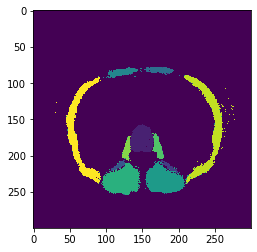

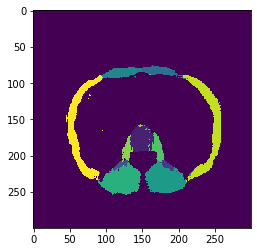

In [67]:
n = np.random.randint(len(Ypred))
plt.imshow(Ypred[n])
plt.show()
plt.imshow(preds[n])

In [68]:
def ragahs(pred):
    out = np.zeros_like(pred)
    out2 = np.zeros_like(pred)
    for val in sorted(np.unique(pred))[1:]:
        val = int(val)
        t = cv2.dilate((pred == val).astype('uint8'), np.ones((3, 3)))
        _1, cnts, _2 = cv2.findContours(t,cv2.RETR_CCOMP,cv2.CHAIN_APPROX_SIMPLE)
        cnts = sorted(cnts, key=lambda x: -len(x))[:1]
        imt = np.zeros_like(pred)
        cv2.drawContours(imt, cnts, 0, val, -1)
        out += imt
        out2 += (imt>0)
    out[np.where(out2>1)] = 0
    return out

In [70]:
Ypred_cleand = np.array([ragahs(p) for p in Ypred])

In [71]:
def gammas(name, pred, x, y):
    out = np.zeros_like(x)
    for val in sorted(np.unique(pred))[1:]:
        n = (cv2.resize((pred==val).astype('uint8'), x.shape[::-1]) > 0)*val
        out += n
    return out

In [155]:
out = [(name, x, gammas(name, pred, x, y)) for pred, (name, x, y) in zip(Ypred_cleand, XY)]

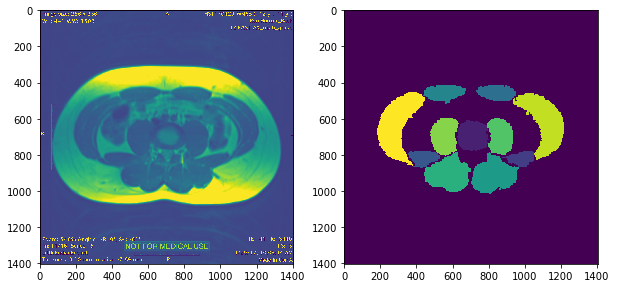

In [156]:
n = np.random.randint(len(out))
fig, axes = plt.subplots(1, 2, figsize=(10, 5))
axes[0].imshow(out[n][1])
axes[1].imshow(out[n][2])

In [157]:
ls *pkl

11_muscle_encoder.pkl                 IXYZ.pkl
11_muscle_predictions.pkl             model_v01.pkl
11_muscle_predictions_v02.pkl         model_v02.pkl
11_muscle_predictions_v03.pkl         new_XYZ.pkl
11_muscle_predictions_v04.pkl         random_forest_v01.pkl
classified_and_raw_11muscles.pkl      raw_images.pkl
classified_and_raw_11muscles_v02.pkl  XYZ_11muscle_full.pkl
cleaned_data2.pkl                     XYZ_11muscle_full_v02.pkl
cleaned_data.pkl                      XYZ_11muscle.pkl
cleaned_muscles-Copy1.pkl             XYZ_11muscle_v02_v02.pkl
cleaned_muscles.pkl                   XYZ.pkl
image_names.pkl                       XYZT.pkl
images.pkl                            Ypred.pkl


In [158]:
file_bar_length = joblib.load("file_bar_length.dict")

In [159]:
font = cv2.FONT_HERSHEY_SIMPLEX 
fontScale = 2
color = 200
def draw_lever_arms(x, pred, scale):
    out = x.copy()
    w, h = x.shape
    for val in sorted(np.unique(pred))[1:]:
        cnt = np.array(np.where((pred==val))).mean(axis=1).astype('int')
        cnt = tuple(x for x in cnt)[::-1]
        cv2.circle(out, cnt, 20, 255, -1)
        if val == 1:
            cv2.line(out, (h//2, 0), (h//2, w), 200, 10)
        else:
            cv2.line(out, cnt, (h//2, cnt[1]), 200, 10)
            d = np.abs(h//2 - cnt[0]) * scale
            cv2.putText(out, '%4.2fcm'%d, cnt, font,  
                   fontScale, 200, 10, cv2.LINE_AA) 
    return out
res_d = [delayed(draw_lever_arms)(*x[1:], 10/file_bar_length[x[0]]) for x in out]

In [160]:
res = compute([delayed(draw_lever_arms)(*x[-1]) for x in res])[0]

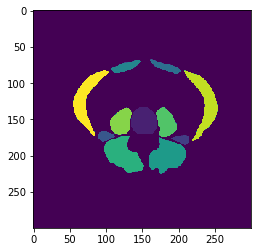

In [221]:
plt.imshow(Y.reshape(-1, 300, 300)[0])

In [253]:
final = [(*x, y, z[2]) for x, y, z in zip(out, res, XY)]

In [254]:
len(final[0])

5

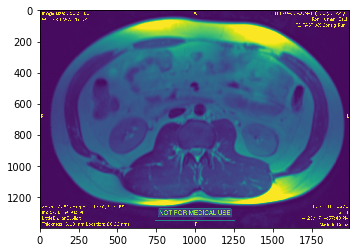

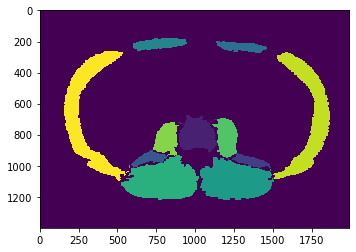

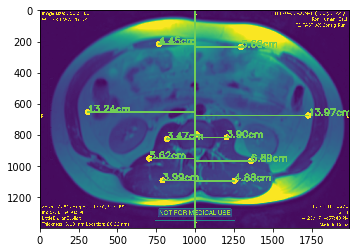

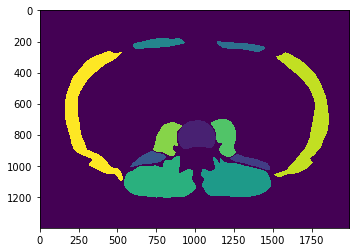

In [256]:
#fig, axes = plt.subplots(1, 1, figsize=(10, 5))
n = np.random.randint(len(final))
plt.imshow(final[n][1])
plt.show()
plt.imshow(final[n][2])
plt.show()
plt.imshow(final[n][3])
plt.show()
plt.imshow(final[n][4])

In [257]:
def dfe(p):
    d = os.path.dirname(p)+"/"
    b = os.path.basename(p)
    return (d, *os.path.splitext(b))
import os
os.mkdir("results2/")
for name, x, y, yy, yyy in final:
    d, f, e = dfe(name)
    os.mkdir("results2/"+f)
    print('results2/'+f+"/original.jpg")
    cv2.imwrite('results2/'+f+"/original.jpg", x)
    cv2.imwrite('results2/'+f+"/predict.jpg", y*10+50)
    cv2.imwrite('results2/'+f+"/lever.jpg", yy)
    cv2.imwrite('results2/'+f+"/marked.jpg", yyy*10+50)

results2/2-COF5-11:50Behnam/original.jpg
results2/1-COF2-6:50Behnam/original.jpg
results2/2-COF1-10:50Behnam/original.jpg
results2/1-COF1-4:50Behnam/original.jpg
results2/1-COF4-5:50Behnam/original.jpg
results2/2-COF4-11:50Behnam/original.jpg
results2/2-COF6-10:50Behnam/original.jpg
results2/1-COF6-4:50Behnam/original.jpg
results2/1-CO5-4:50Behnam/original.jpg
results2/2-CO5-10:50Behnam/original.jpg
results2/2-CO1-10:50Behnam/original.jpg
results2/1-CO1-4:50Behnam/original.jpg
results2/3-CO1-15:50Behnam/original.jpg
results2/1-CO6-4:50Behnam/original.jpg
results2/2-CO6-10:50Behnam/original.jpg
results2/1-CO4-1:50Post/original.jpg
results2/3-CO4-12:50Behnam/original.jpg
results2/2-CO4-6:50Behnam/original.jpg
results2/1-CO2RR-5:50Behnam/original.jpg
results2/1-COF6B-4:50BehnamPost/original.jpg
results2/2-COF1B-8:50BehnamPost/original.jpg
results2/1-COF7B-5:50BehnamPost/original.jpg
results2/2-COF7B-11:50BehnamPost/original.jpg
results2/2-COF4B-10:50BehnamPost/original.jpg
results2/1-COF4

results2/1-WF4B-3:50RepBeh/original.jpg
results2/2-WF5B-9:50RepBeh/original.jpg
results2/2-WF1B-10:50RepBeh/original.jpg
results2/1-WF1B-4:50RepBeh/original.jpg
results2/2-WM4B-10:50RepBeh/original.jpg
results2/2-WM2B-10:50RepBeh/original.jpg
results2/1-WM2B-4:50RepBeh/original.jpg
results2/2-WM9B-10:50RepBeh/original.jpg
results2/1-WM9B-6:50RepBeh/original.jpg
results2/1-WM1B-3:50RepBeh/original.jpg
results2/2-WM8B-9:50RepBeh/original.jpg
results2/1-WM8B-5:50RepBeh/original.jpg
results2/2-FCWF5-9:50Beh-Rep/original.jpg
results2/2-FCWF2-10:50Beh-Rep/original.jpg
results2/1-FCWF2-4:50Beh-Rep/original.jpg
results2/2-FCWF6-11:50Beh-Rep/original.jpg
results2/1-FCWF4-1:50Beh-Rep/original.jpg
results2/2-FCWF1-10:50Beh-Rep/original.jpg
results2/1-FCWF1-5:50Beh-Rep/original.jpg
results2/2-FCWM4-9:50Beh-Rep/original.jpg
results2/1-FCWM4-2:50Beh-Rep/original.jpg
results2/2-FCWM9-4:50Beh-Rep/original.jpg
results2/1-FCWM9-1:50Beh-Rep/original.jpg
results2/3-FCWM6-11:50Beh-Rep/original.jpg
results2

In [216]:
rm -r results

#  Further

In [22]:
%load_ext autoreload
%autoreload 2
%reset -f
from custom_imports import *

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [23]:
#client = Client(scheduler_file='/home/bzr0014/schedfile')
#client.restart()

In [25]:
XY = joblib.load('classified_and_raw_11muscles_v02.pkl')
XYZ = joblib.load('XYZ_11muscle_full_v02.pkl')

In [26]:
#XYZ[0][1] - XY[0][1]

In [27]:
def get_neighbors(x, y, neigh_size, z=None, size=1000):
    np.random.seed(random.randint(0, 1000))
    m = neigh_size//2
    m2 = neigh_size-m
    if z is None:
        z = np.zeros_like(x)
        z[:, m:-m2, m:-m2] = 1
    indices = np.array(np.where(z)).T
    #print(indices.shape)
    f = list(range(len(indices)))
    X = np.array([x[i, j-m:j+m, k-m:k+m]
            for i, j, k, t in indices])
    if y is not None:
        c = y.shape[-1]
        Y = np.array([y[i, j, k]
                for i, j, k, t in indices]).reshape(-1, c)
        return X, Y
    return X

In [28]:
model_data = joblib.load('model_11muscles')

In [42]:
len(model_data)

5

In [43]:
X = np.array([x[1] for x in XYZ])
Y = np.array([x[2] for x in XYZ])
Z = np.array([x[3] for x in XYZ if x[3] is not None])
X = X.reshape(*X.shape, 1)
Y = Y.reshape(*Y.shape, 1)
if len(Z) == len(Y):
    Z = Z.reshape(*Y.shape, 1)
encoder = model_data[0]
Y = encoder.fit_transform(Y.reshape(-1, 1)).toarray().reshape(*Y.shape, -1)
X = (X-X.mean())/X.std()

In [44]:
X.mean(), model_data[1].mean()

(1.0881229834489391e-16, -0.003889834608226947)

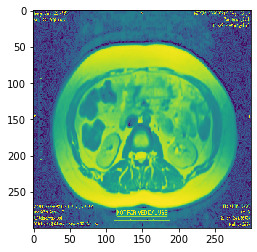

In [49]:
plt.imshow(X[3, :, :, 0])

In [89]:
from keras.models import load_model
neighSizes = [41, 82]
model_names = {neigh_size: (neigh_size, f'/home/bzr0014/git/sesek2/model_11muscles_{neigh_size}_v01.model') for neigh_size in neighSizes}
model_names['17bin'] = (17, f'/home/bzr0014/git/sesek2/best_so_far_neighbor_17_2020-04-13_17_23_17_464782.model_v03')
neighSizes = [41, 82]
models = {k: (v[0], load_model(v[1])) for k, v in model_names.items()}

In [90]:
models = {neigh_size: (neigh_size, load_model(f'model_11muscles_{neigh_size}_v01.model')) for neigh_size in neighSizes}
#models['17bin'] = (17, load_model(f'best_so_far_neighbor_17_2020-04-13_17_23_17_464782.model_v03'))

In [91]:
try:
    print(len(YPrs))
except NameError:
    print("not existing")
    YPrs = {}

not existing


In [92]:
neighSizes = [41, 82]
for label, (neigh_size, m) in models.items():
    for n in range(len(X)):
        if (label, neigh_size, n) in YPrs:
            continue
        x, y = get_neighbors(X[n:n+1], Y[n:n+1], neigh_size)
        out = m.predict(x)
        shape = int(np.sqrt(out.shape[0]))
        if label != '17bin':
            out = encoder.inverse_transform(out)
        print(label, neigh_size, n, shape)
        YPrs[(label, neigh_size, n)] = out.reshape(shape, shape)
        print("*************************")

41 41 0 259
*************************
41 41 1 259
*************************


KeyboardInterrupt: 

In [13]:
X

NameError: name 'X' is not defined

In [25]:
joblib.dump((XY, XYZ, YPrs), '11_muscle_predictions_v04.pkl')

['11_muscle_predictions_v04.pkl']

In [79]:
%load_ext autoreload
%autoreload 2
%reset -f  
from custom_imports import *

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [28]:
out = joblib.load('11_muscle_predictions_v03.pkl')

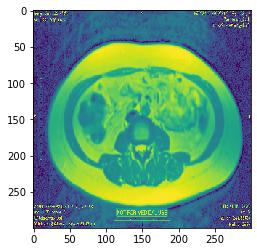

In [47]:
plt.imshow([x for x in XYZ if x[3] is not None][0][1])

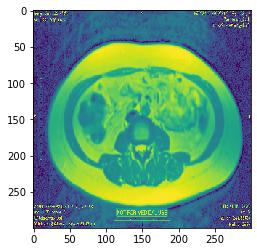

In [53]:
plt.imshow(out[0][0])

In [108]:
import tensorflow as tf 
if tf.test.gpu_device_name(): 
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))
else:
   print("Please install GPU version of TF")

Default GPU Device: /gpu:0


In [109]:
plt.imshow(Y,Prs[(82, 82, 17)])

NameError: name 'Y' is not defined

In [165]:
_n = np.random.randint(len(X))
print(_n)
plt.imshow(YPrs[(41, 41, _n)])

137


NameError: name 'YPrs' is not defined

In [14]:
#this part
import tensorflow as tf
global graph
global graph
graph = tf.get_default_graph()

def predict_(args):
    label, model_path, x, neigh_size = args
    from keras.models import load_model
    model = load_model(model_path)
    x = get_neighbors(x.reshape(1, *x.shape), None, neigh_size)
    global graph
    with graph.as_default():
        out = model.predict(x)
    shape = int(np.sqrt(out.shape[0]))
    if label != '17bin':
        out = encoder.inverse_transform(out)
    return out.reshape(shape, shape)

In [15]:
res = ([(label, model_path, x, neigh_size) for label, (neigh_size, model_path) in model_names.items() for x in X])

In [16]:
res2 = bag.from_sequence(res)

In [17]:
res3 = res2.map(predict_)

In [18]:
import dask
from multiprocessing import Pool
res4 = res3.compute(scheduler='threads')

TypeError: Cannot interpret feed_dict key as Tensor: Tensor Tensor("Placeholder:0", shape=(10, 10, 1, 32), dtype=float32) is not an element of this graph.

In [50]:
res4

NameError: name 'res4' is not defined

In [436]:
neighSizes = ['17bin']
for neigh_size in neighSizes:
    m = load_model(f'best_so_far_neighbor_17_2020-04-13_17_23_17_464782.model_v03')
    for _n in range(len(X)):
        print(_n)
        if (neigh_size, _n) in YPrs:
                   continue
        _x, _y = get_neighbors(X[_n:_n+1], Y[_n:_n+1], 17)
        out = m.predict(_x)
        shape = int(np.sqrt(out.shape[0]))
        print(shape)
        YPrs[(neigh_size, _n)] = (out).reshape(shape, shape)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
(70756, 4)
266
14
(70756, 4)
266
15
(70756, 4)
266
16
(70756, 4)
266
17
(70756, 4)
266
18
(70756, 4)
266
19
(70756, 4)
266
20
(70756, 4)
266
21
(70756, 4)
266
22
(70756, 4)
266
23
(70756, 4)
266
24
(70756, 4)
266
25
(70756, 4)
266
26
(70756, 4)
266
27
(70756, 4)
266
28
(70756, 4)
266
29
(70756, 4)
266
30
(70756, 4)
266
31
(70756, 4)
266
32
(70756, 4)
266
33
(70756, 4)
266
34
(70756, 4)
266
35
(70756, 4)
266
36
(70756, 4)
266
37
(70756, 4)
266
38
(70756, 4)
266
39
(70756, 4)
266
40
(70756, 4)
266
41
(70756, 4)
266
42
(70756, 4)
266
43
(70756, 4)
266
44
(70756, 4)
266
45
(70756, 4)
266
46
(70756, 4)
266
47
(70756, 4)
266
48
(70756, 4)
266
49
(70756, 4)
266
50
(70756, 4)
266
51
(70756, 4)
266
52
(70756, 4)
266
53
(70756, 4)
266
54
(70756, 4)
266
55
(70756, 4)
266
56
(70756, 4)
266
57
(70756, 4)
266
58
(70756, 4)
266
59
(70756, 4)
266
60
(70756, 4)
266
61
(70756, 4)
266
62
(70756, 4)
266
63
(70756, 4)
266
64
(70756, 4)
266
65
(70756, 4)
266
66
(70756, 4)
266

300 218


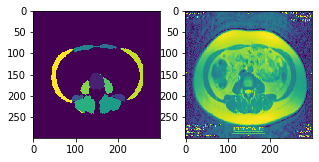

300 218


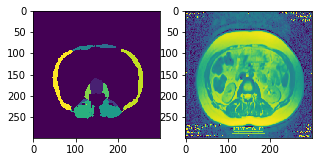

300 218


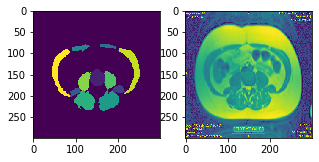

300 218


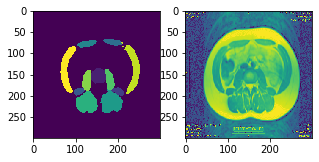

300 218


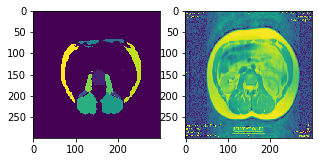

300 218


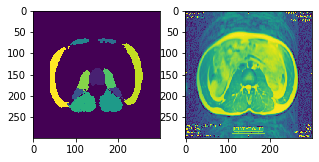

300 218


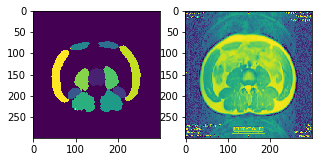

300 218


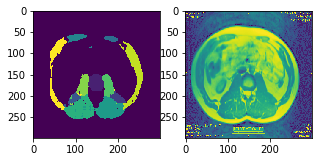

300 218


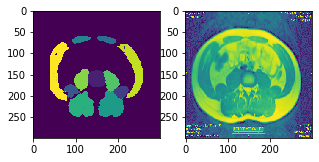

300 218


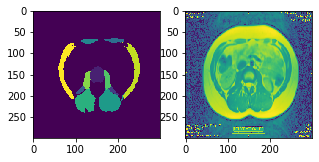

300 218


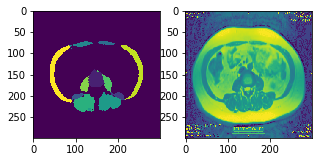

300 218


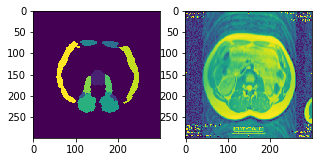

300 218


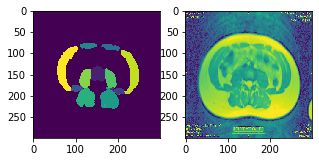

300 218


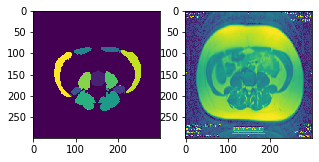

300 218


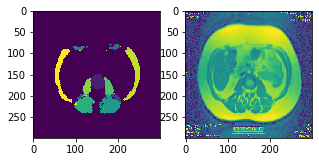

300 218


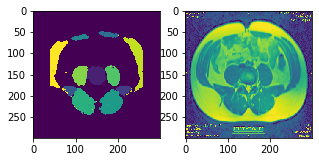

300 218


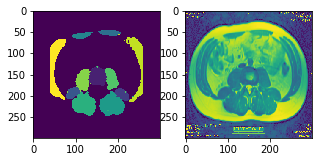

300 218


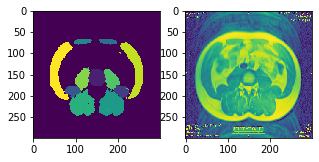

300 218


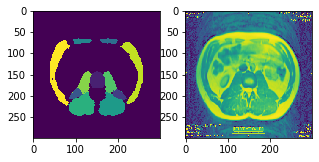

300 218


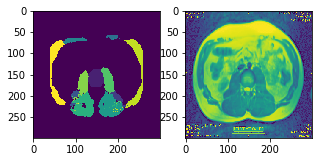

300 218


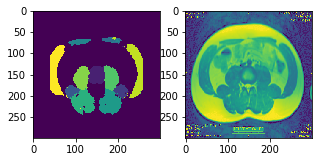

300 218


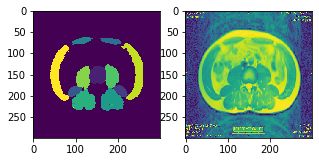

300 218


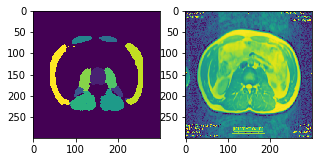

300 218


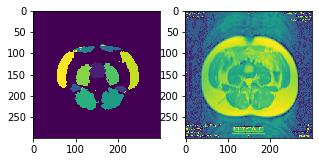

300 218


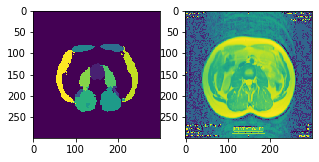

300 218


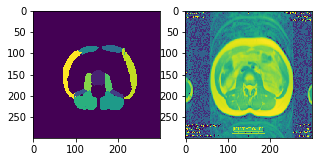

300 218


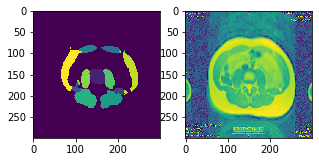

300 218


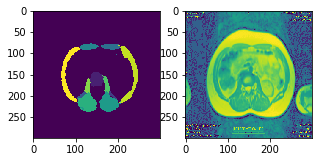

300 218


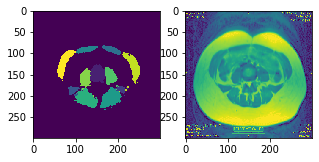

300 218


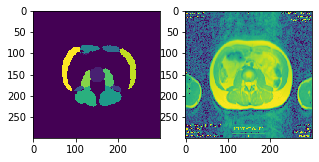

300 218


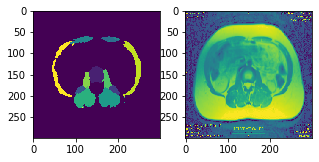

300 218


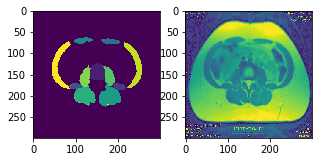

300 218


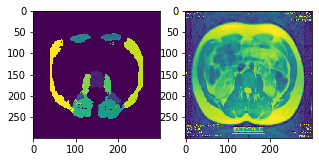

300 218


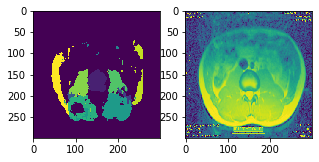

300 218


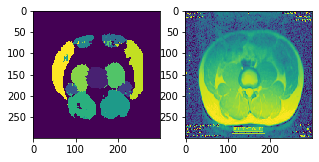

300 218


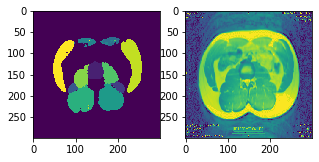

300 218


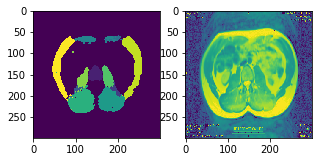

300 218


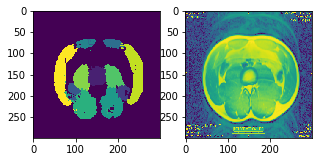

300 218


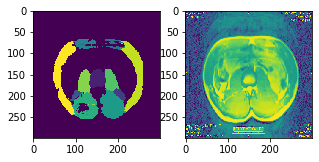

300 218


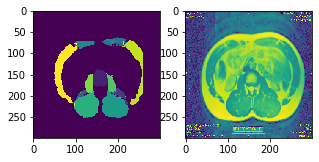

300 218


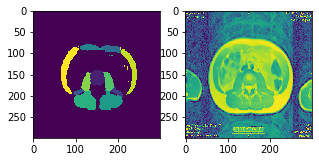

300 218


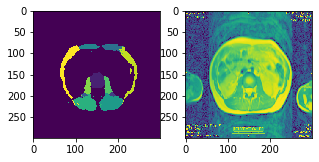

300 218


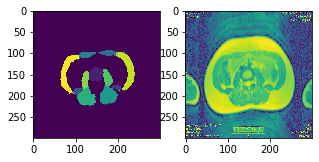

300 218


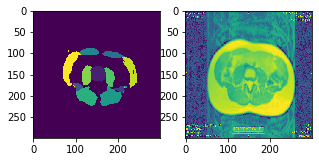

300 218


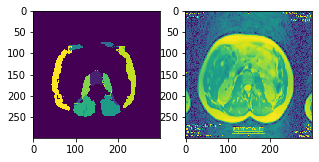

300 218


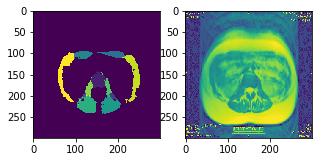

300 218


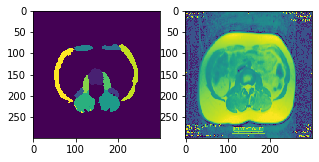

300 218


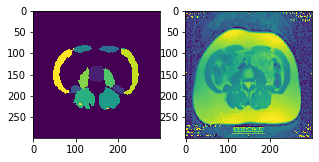

300 218


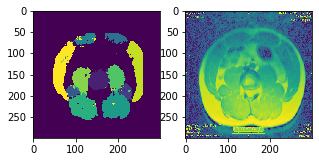

300 218


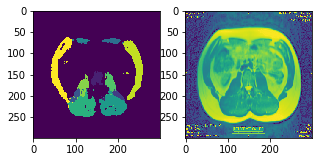

300 218


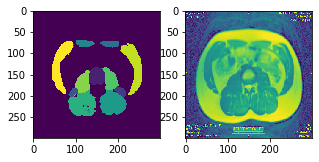

300 218


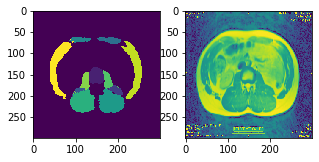

300 218


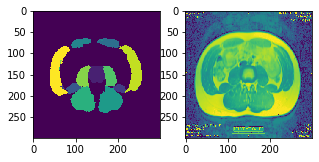

300 218


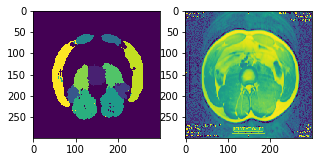

300 218


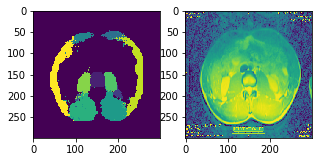

300 218


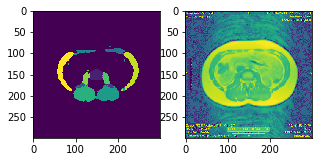

300 218


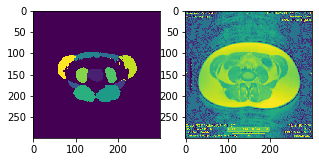

300 218


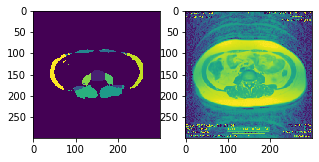

300 218


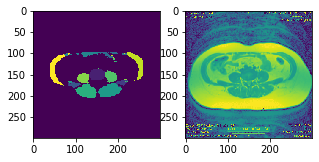

300 218


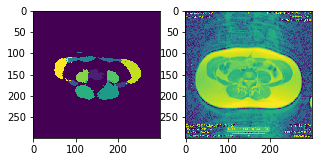

300 218


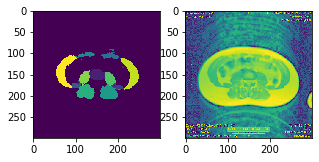

300 218


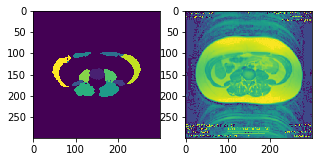

300 218


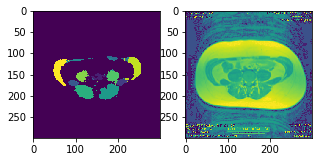

300 218


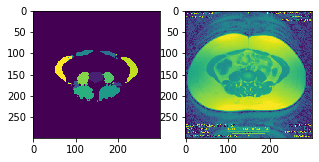

300 218


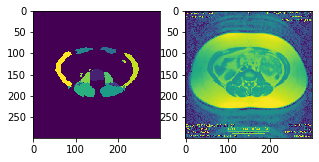

300 218


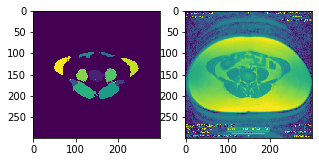

300 218


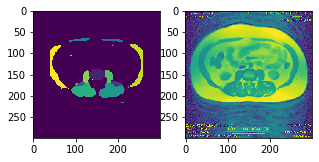

300 218


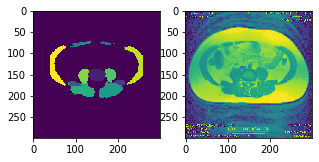

300 218


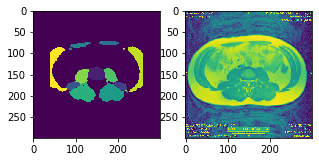

300 218


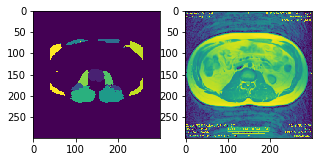

300 218


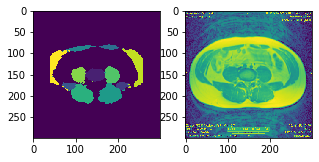

300 218


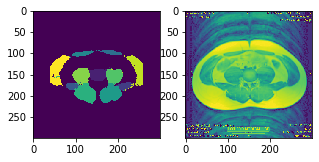

300 218


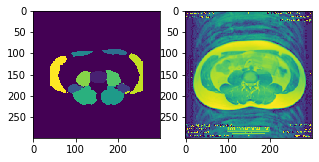

300 218


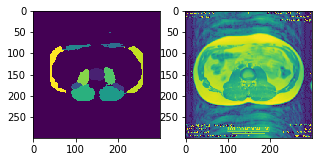

300 218


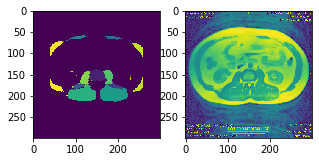

300 218


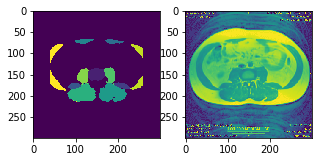

300 218


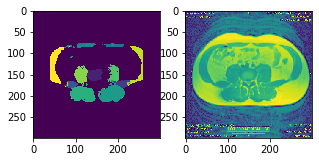

300 218


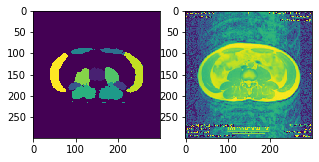

300 218


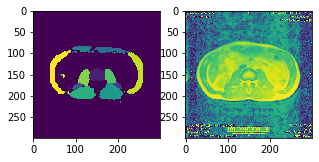

300 218


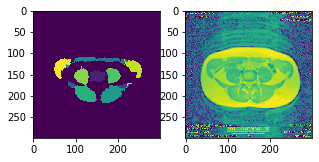

300 218


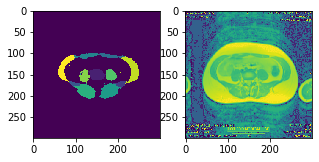

300 218


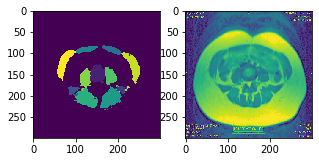

300 218


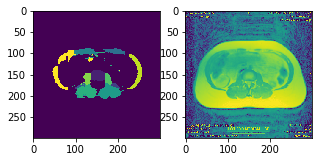

300 218


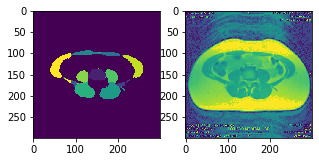

300 218


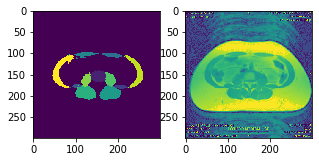

300 218


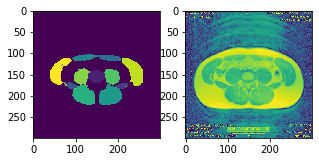

300 218


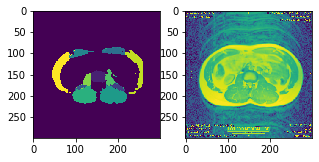

300 218


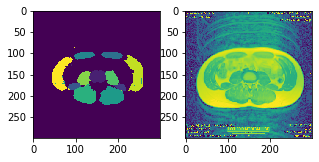

300 218


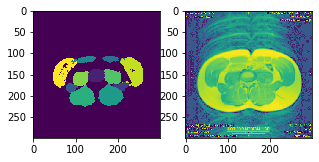

300 218


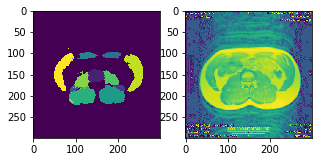

300 218


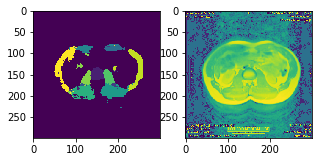

300 218


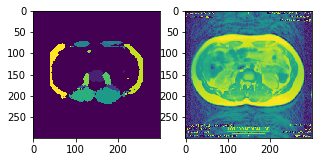

300 218


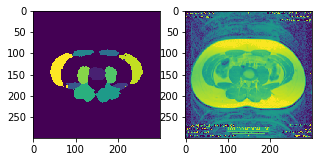

300 218


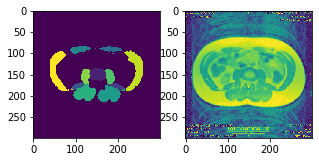

300 218


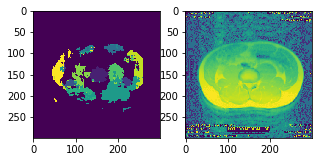

300 218


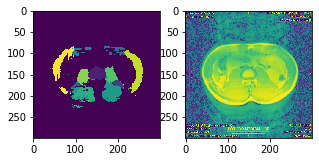

300 218


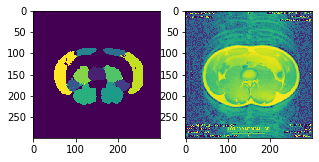

300 218


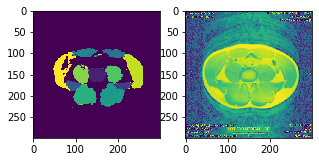

300 218


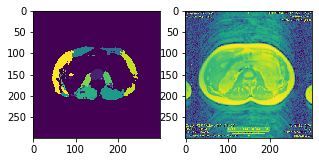

300 218


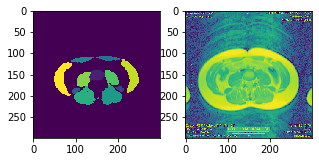

300 218


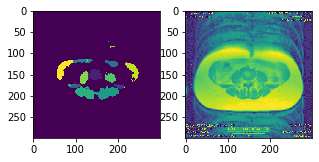

300 218


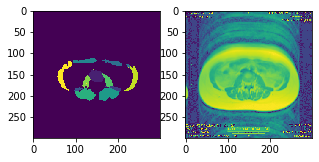

300 218


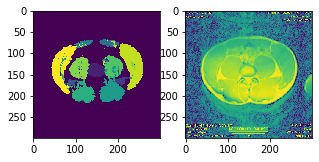

300 218


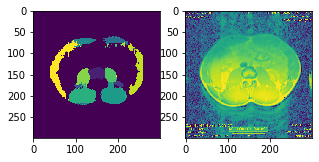

300 218


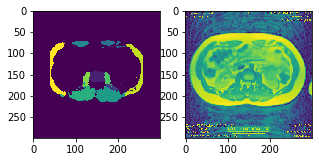

300 218


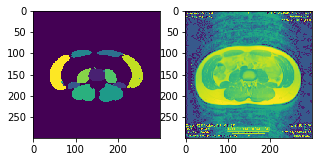

300 218


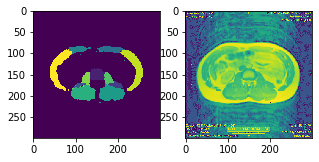

300 218


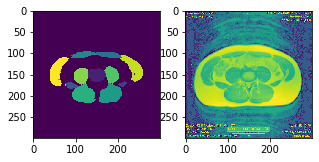

300 218


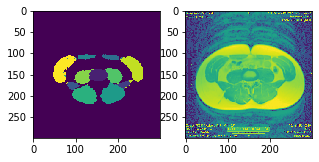

300 218


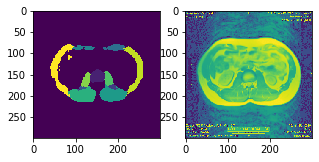

300 218


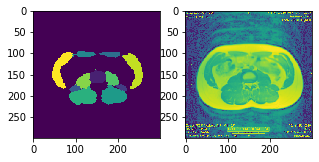

300 218


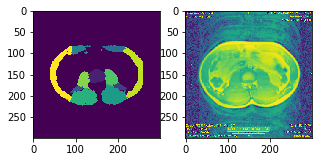

300 218


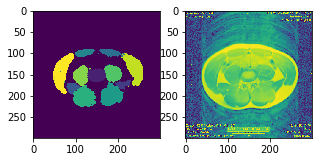

300 218


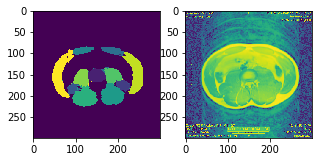

300 218


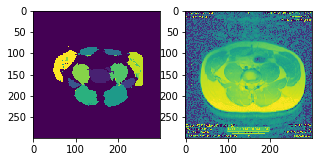

300 218


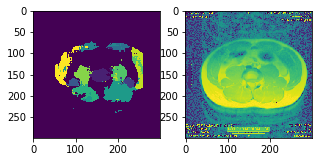

300 218


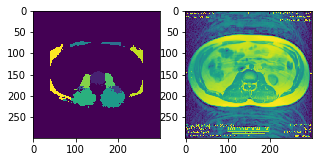

300 218


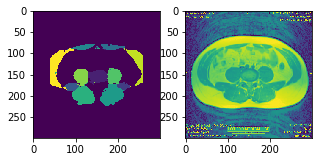

300 218


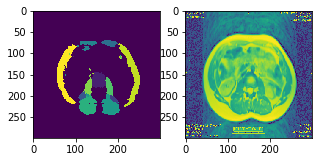

300 218


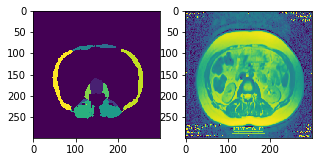

300 218


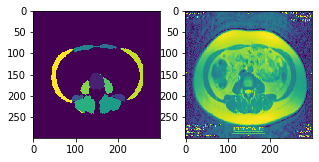

300 218


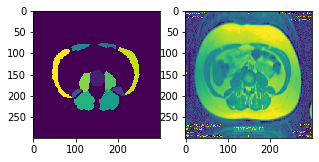

300 218


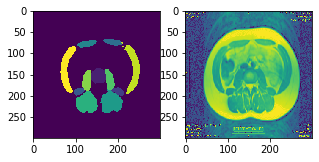

300 218


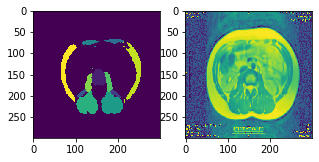

300 218


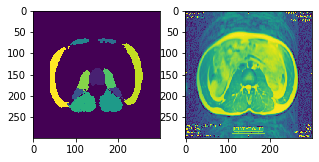

300 218


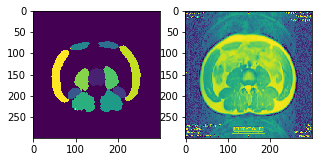

300 218


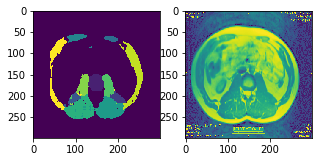

300 218


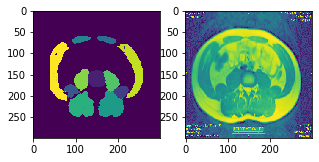

300 218


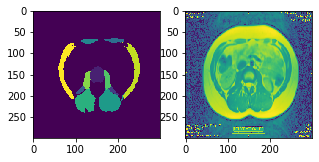

300 218


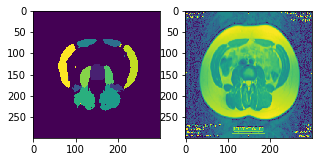

300 218


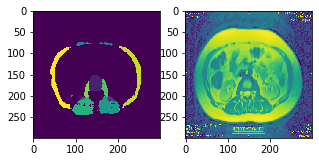

300 218


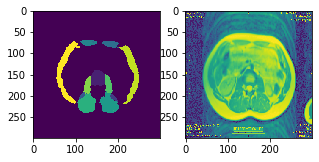

300 218


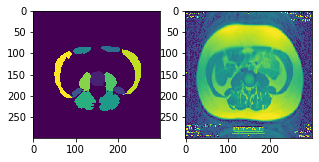

300 218


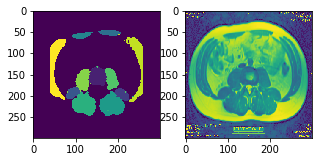

300 218


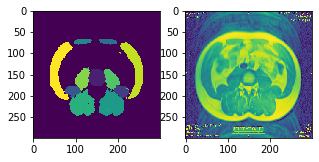

300 218


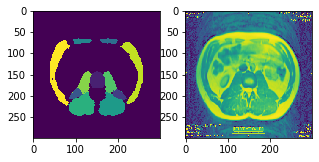

300 218


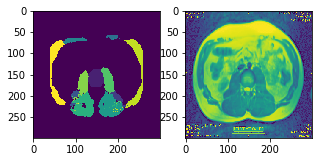

300 218


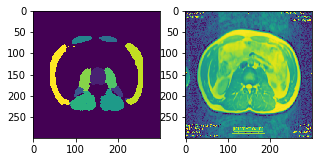

300 218


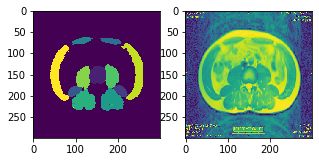

300 218


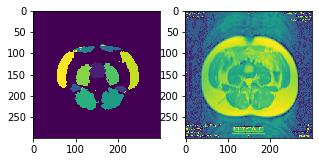

300 218


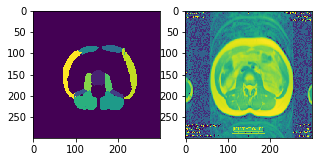

300 218


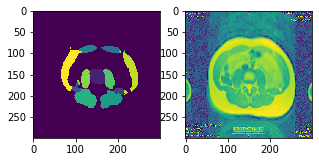

300 218


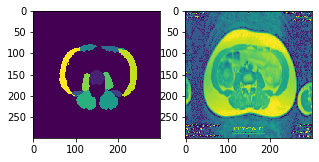

300 218


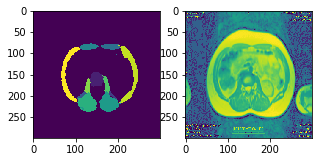

300 218


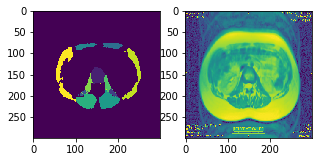

300 218


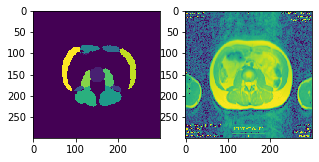

300 218


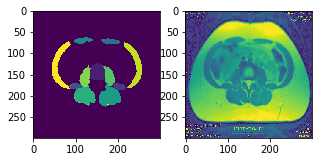

300 218


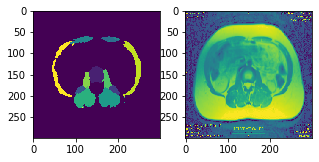

300 218


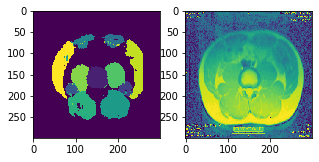

300 218


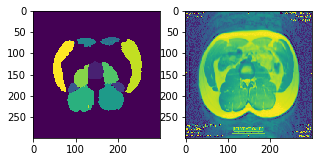

300 218


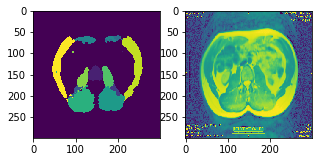

300 218


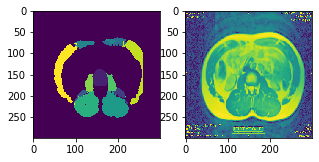

300 218


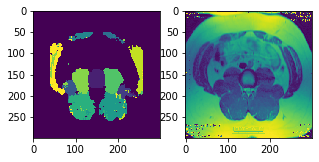

300 218


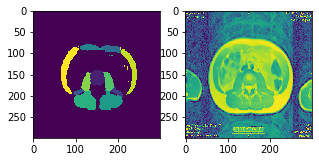

300 218


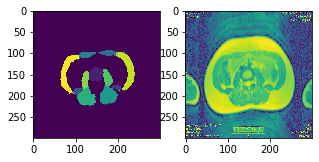

300 218


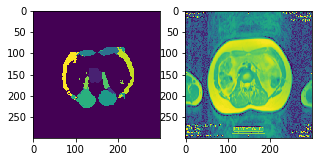

300 218


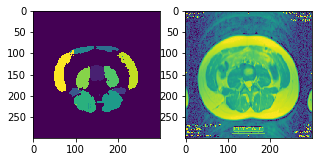

300 218


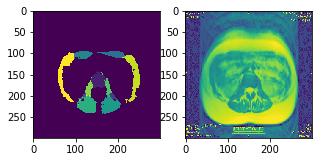

300 218


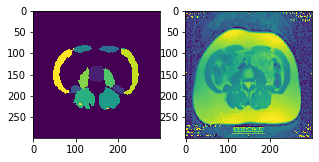

300 218


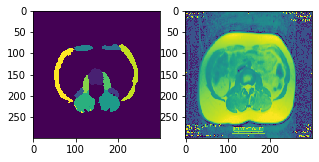

300 218


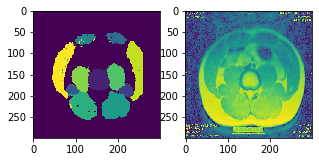

300 218


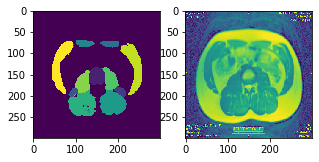

300 218


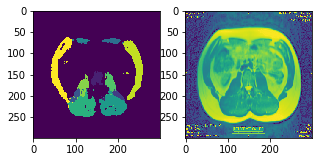

300 218


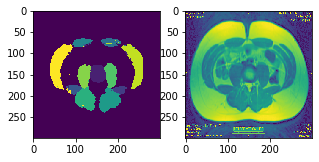

300 218


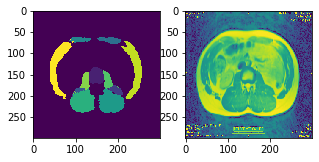

300 218


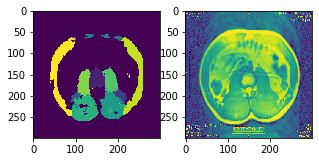

300 218


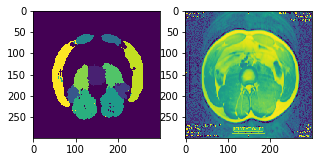

In [250]:
_n = 25
_n = np.random.randint(len(Xtr))
res = []
for _n in range(len(X)):
    _y41 = YPrs[(41, _n)]
    _y82 = YPrs[(82, _n)]
    os = X[_n].shape[0]
    ns, ms = _y41.shape
    _t = (os-ns)//2
    print(os, ns, )
    imt1 = np.zeros((os, os))
    imt1[_t:-_t, _t:-_t] = _y41

    ns, ms = _y82.shape
    _t = (os-ns)//2
    imt2 = np.zeros((os, os))
    imt2[_t:-_t, _t:-_t] = _y82
    #print(orig_s, orig_s-_s)
    #_x = np.zeros((orig_s, orig_s))
    #plt.imshow(imt1)
    #plt.show()
    #plt.imshow(imt2)
    #plt.show()
    fig, axes = plt.subplots(1, 2, figsize=(5, 2.5))
    imt2[np.where(imt2==0)] = imt1[np.where(imt2==0)]
    axes[0].imshow(imt2)
    axes[1].imshow(X[_n, :, :, 0])
    plt.show()
    res.append((X[_n, :, :, 0], imt2))

In [51]:
res = joblib.load('11_muscle_predictions.pkl')

In [445]:
_n = 25
_n = np.random.randint(len(Xtr))
res2 = []
for _n in range(len(X)):
    _y17bin = YPrs[('17bin', _n)]
    os = X[_n].shape[0]
    ns, ms = _y17bin.shape
    _t = (os-ns)//2
    print(os, ns, )
    imt1 = np.zeros((os, os))
    imt1[_t:-_t, _t:-_t] = _y17bin
    res2.append(imt1)

300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266
300 266


In [447]:
res3 = [(x, y, z) for (x, y), z in zip(res, res2)]

In [585]:
joblib.dump(res5, '11_muscle_predictions_v03.pkl')

['11_muscle_predictions_v03.pkl']

In [52]:
res5 = joblib.load('11_muscle_predictions_v03.pkl')

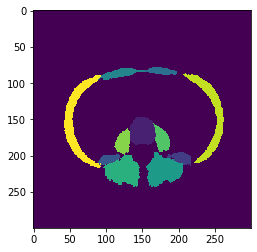

In [63]:
plt.imshow(res5[0][3])

0
12 0
26 0


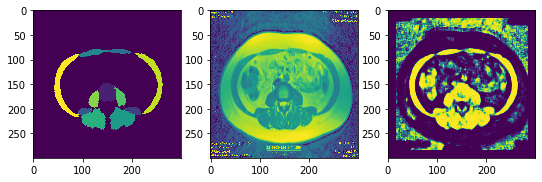

1
5 0
1 0


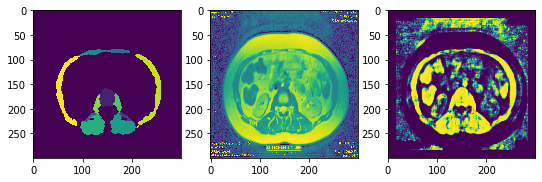

2
29 0
20 0


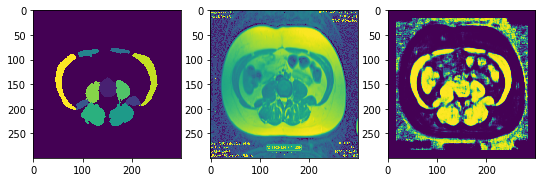

3
27 0
9 0


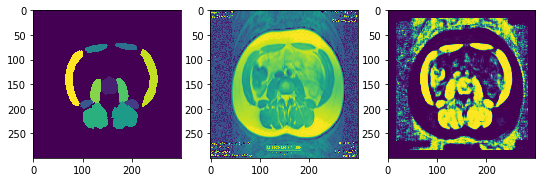

4
13 0


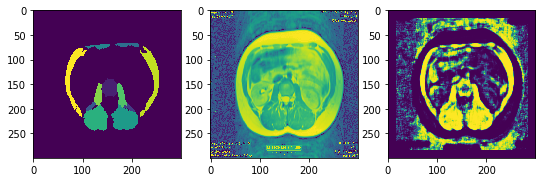

5
53 0
38 0


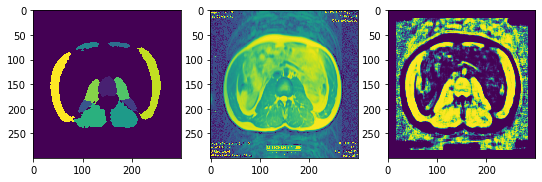

6
10 0
3 0


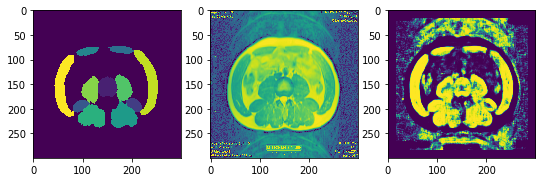

7
54 0
20 0


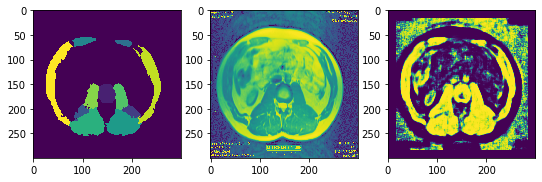

8
45 0
22 0


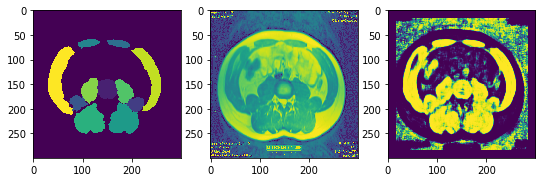

9
0 0
0 0


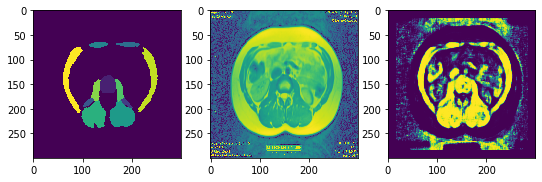

10
33 0
26 0


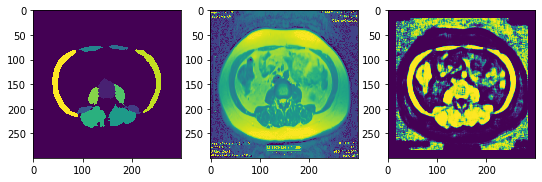

11
24 0
32 0


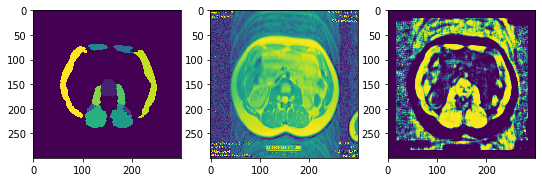

12
22 0
19 0


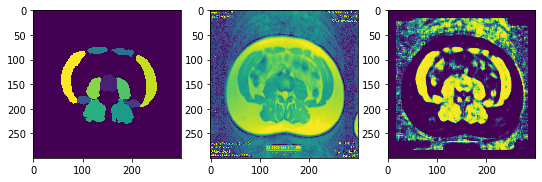

13
32 0


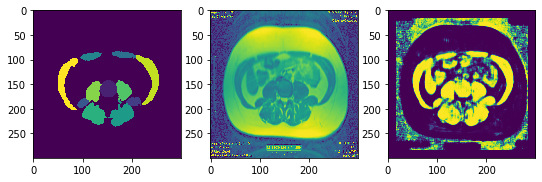

14
17 0


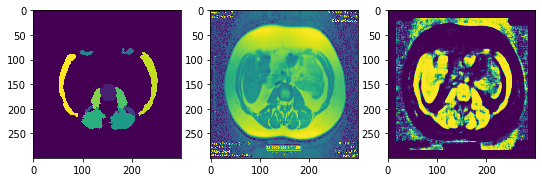

15
7 0
31 0


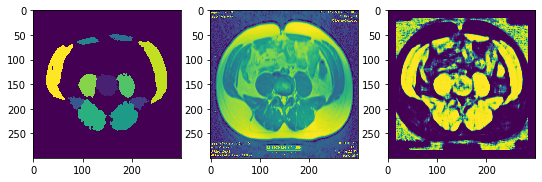

16
9 0
14 0


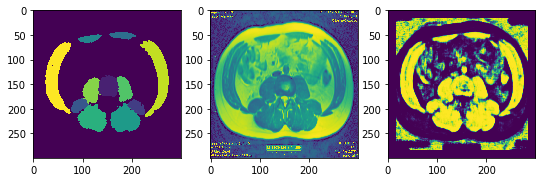

17
36 0
42 0


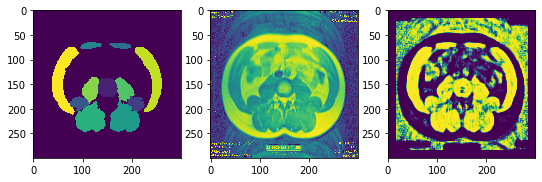

18
61 0
27 0


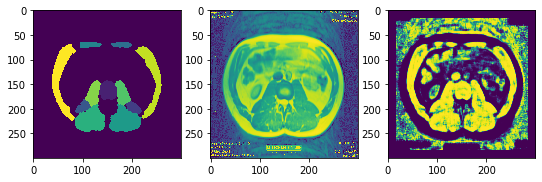

19
46 0
33 0
41 0


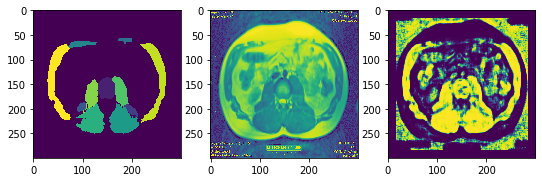

20
24 0
22 0


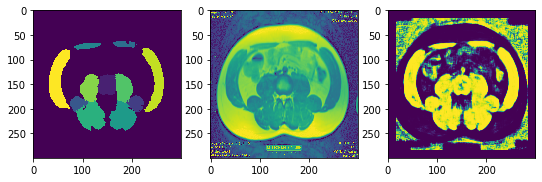

21
39 0
35 0


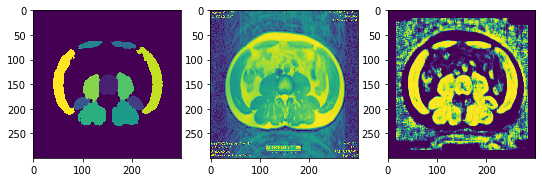

22
29 0
10 0


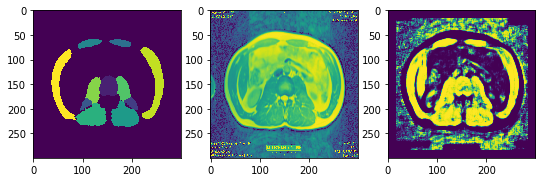

23
10 0
0 0


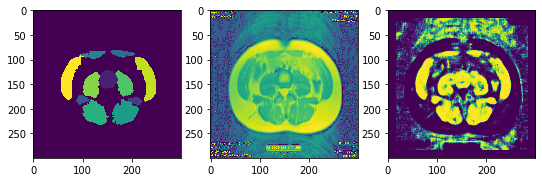

24
2 0
0 0


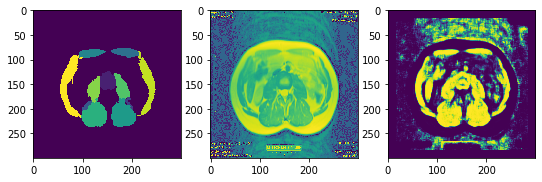

25
4 0
4 0


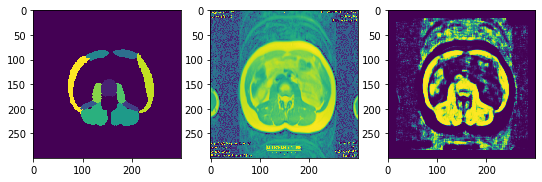

26
7 0
1 0


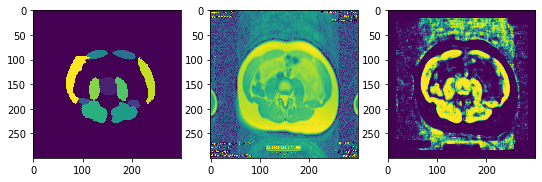

27
4 0
2 0


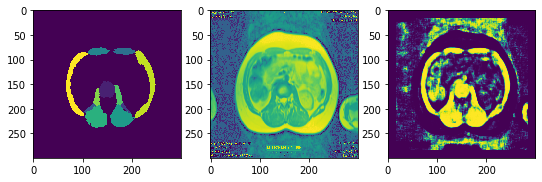

28
26 0


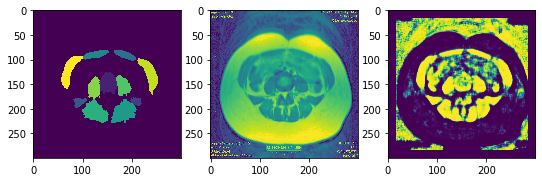

29
2 0
2 0


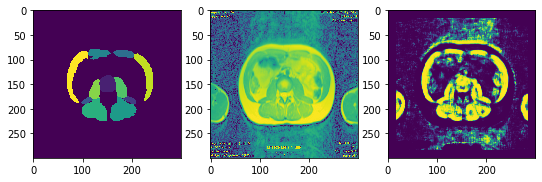

30
9 0


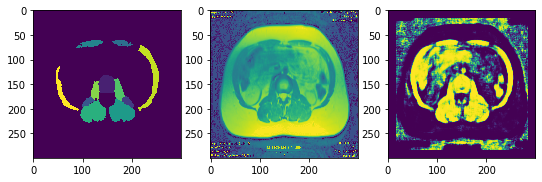

31
9 0


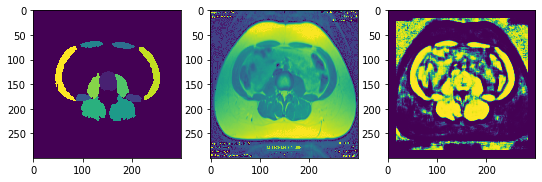

32
16 0
11 0


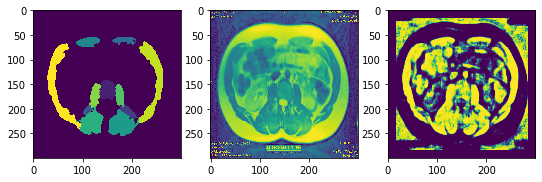

33
3 0
8 0
12 0
4 0


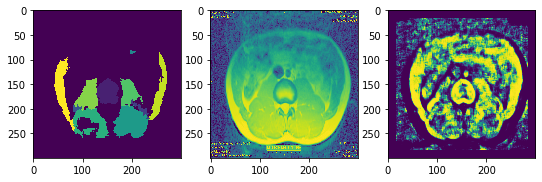

34
6 0
3 0


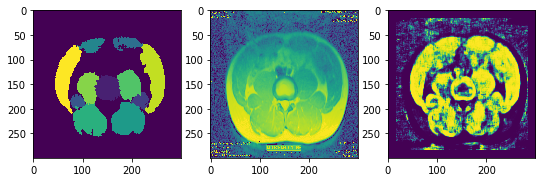

35
33 0
25 0


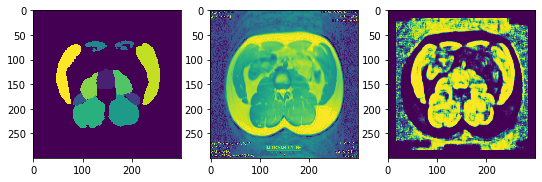

36
32 0
10 0


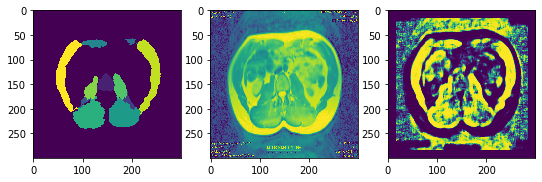

37
11 0
2 0


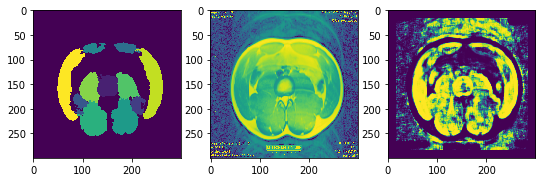

38
7 0
2 0


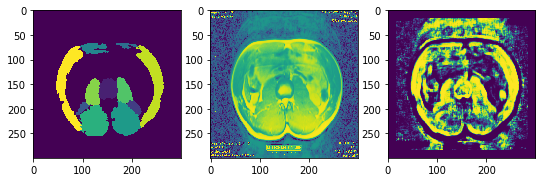

39
16 0
14 0


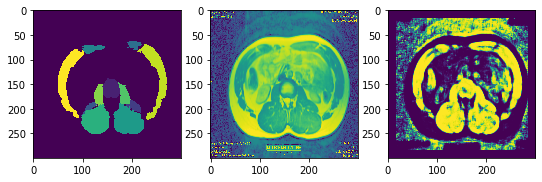

40
7 0
8 0


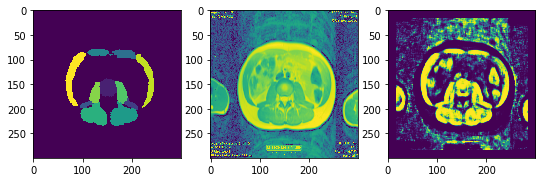

41
14 0
10 0


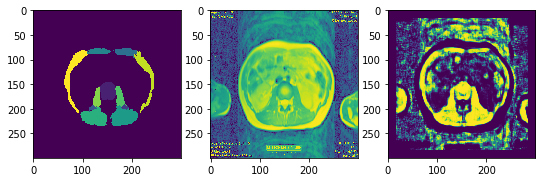

42
9 0


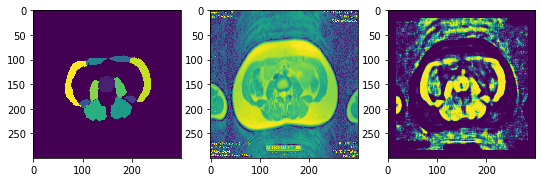

43
5 0


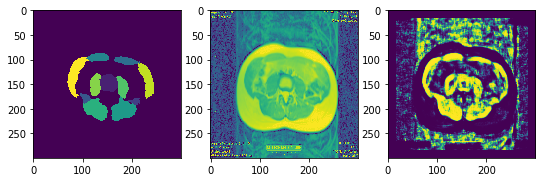

44
7 0
0 0


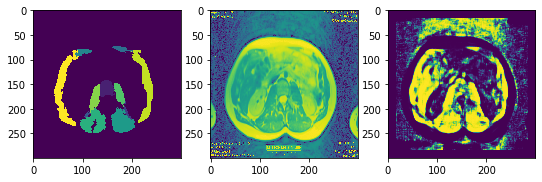

45
39 0


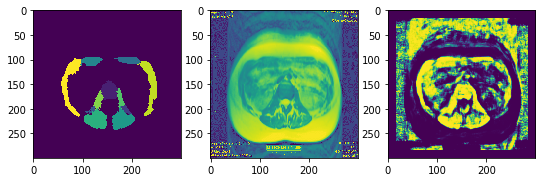

46
11 0


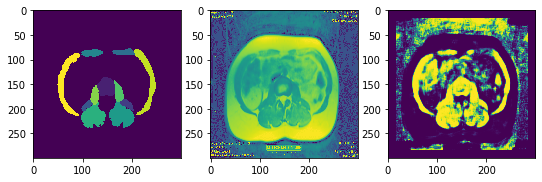

47
8 0


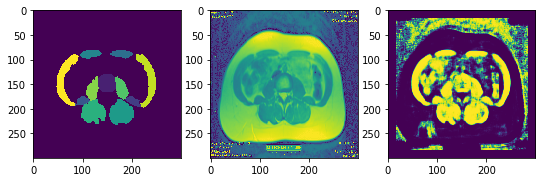

48
2 0
3 0


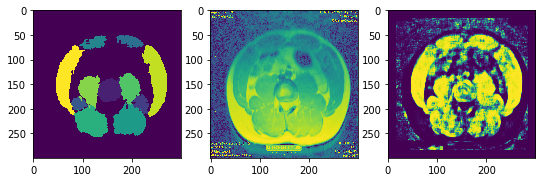

49
31 0
19 0


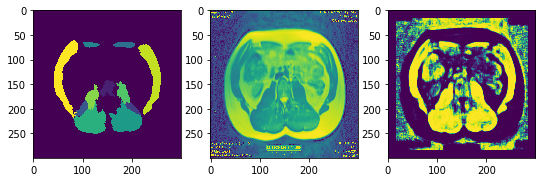

50
23 0
19 0


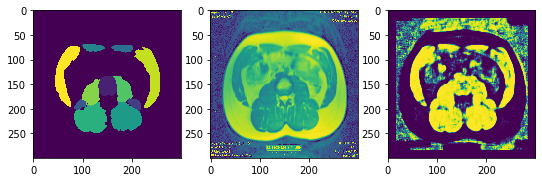

51
31 0
14 0


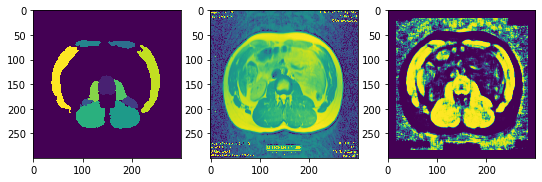

52
23 0
7 0


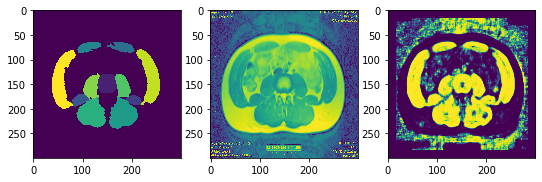

53
10 0
2 0


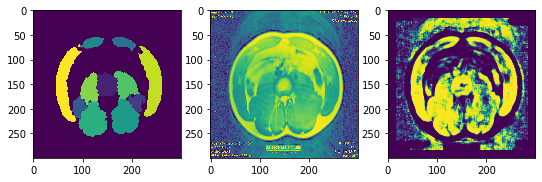

54
10 0
2 0


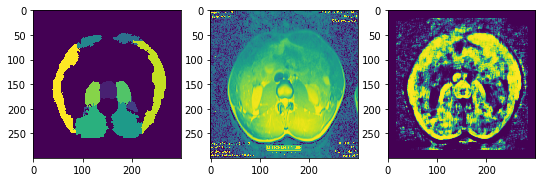

55
1 0
0 0


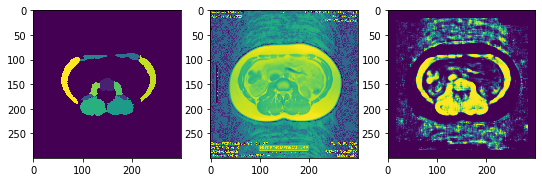

56
2 0


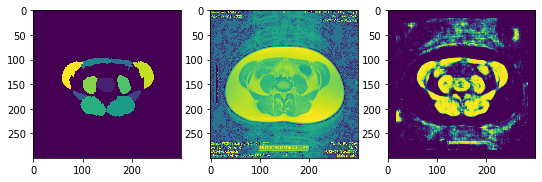

57
6 0
4 0


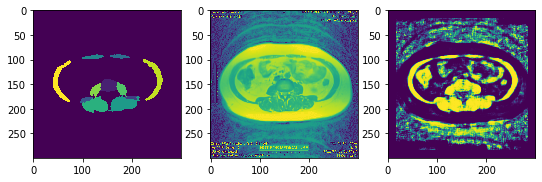

58
1 0
2 0


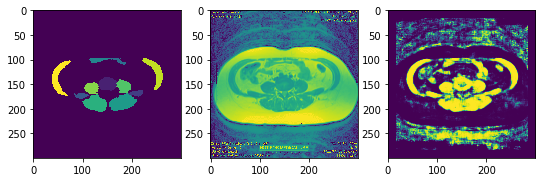

59
1 0


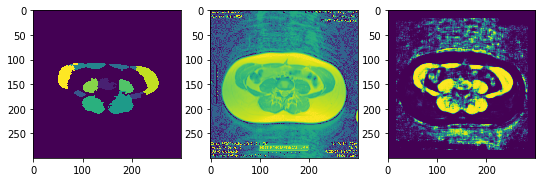

60
5 0


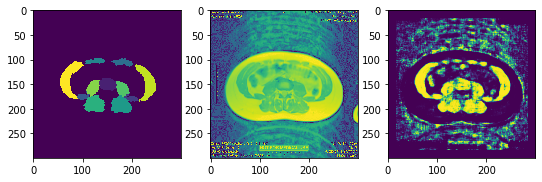

61


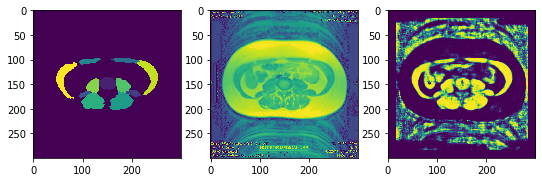

62
7 0


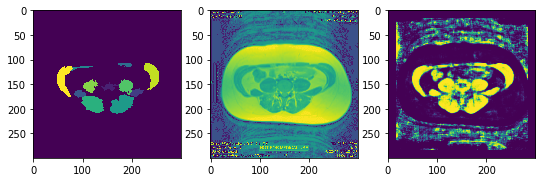

63
18 0


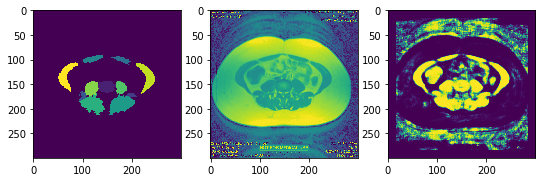

64
4 0
13 0


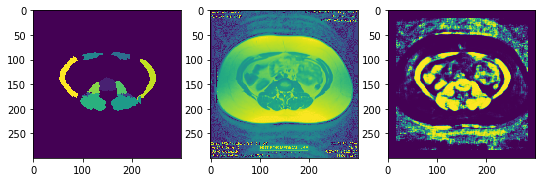

65
4 0
8 0


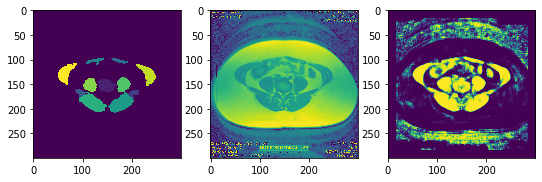

66
21 0
23 0


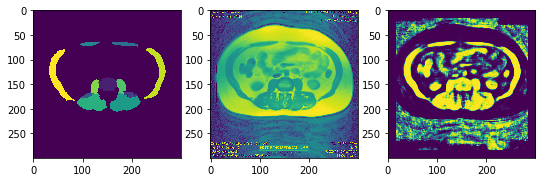

67
21 0
16 0


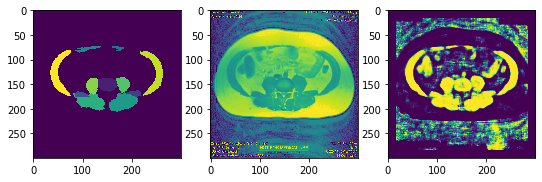

68
25 0
18 0


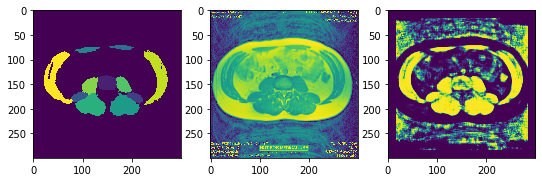

69
24 0
26 0


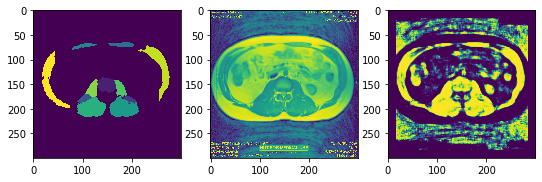

70
27 0
38 0


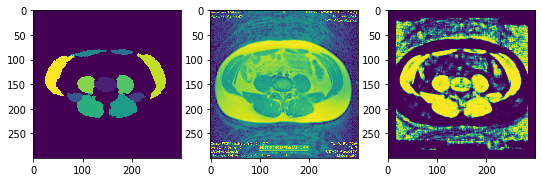

71
8 0
9 0
23 0


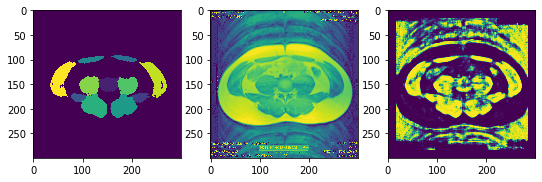

72
9 0
11 0
27 0


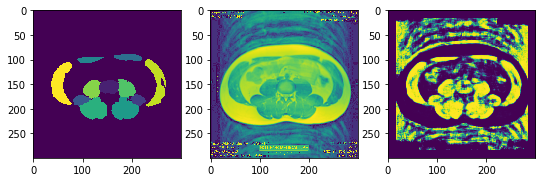

73
8 0
32 0
35 0


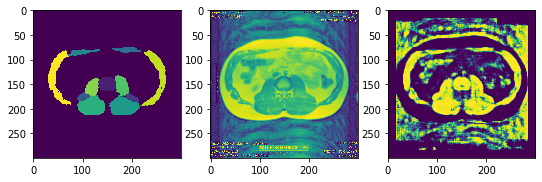

74
33 0
23 0


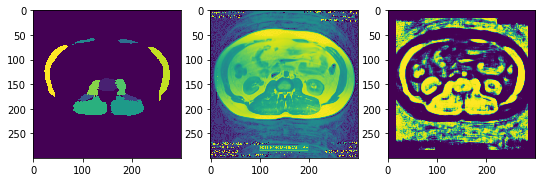

75
21 0
19 0


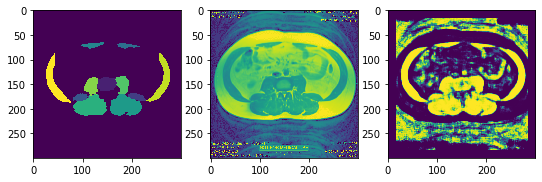

76
3 0
14 0


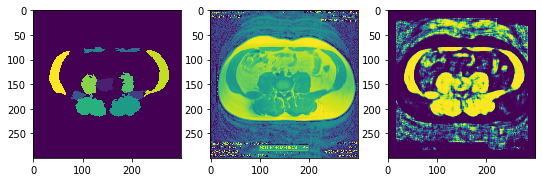

77
8 0
2 0


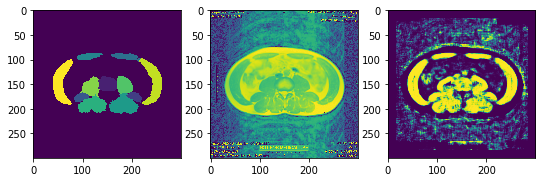

78
4 0
0 0


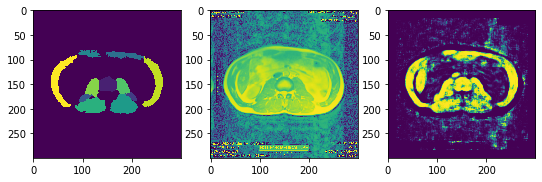

79
0 0


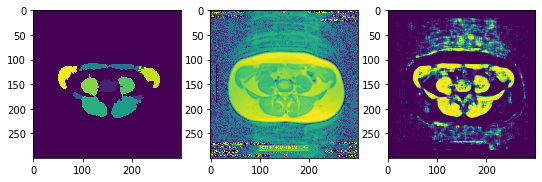

80
3 0
5 0


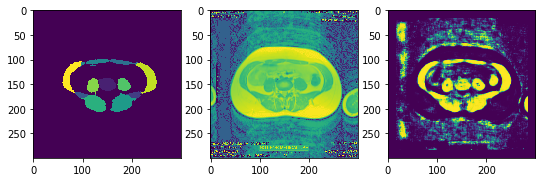

81
35 0


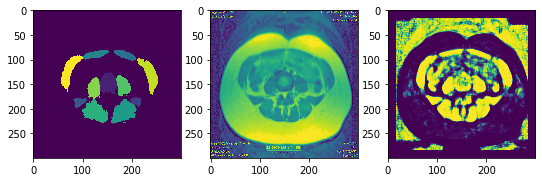

82
0 0


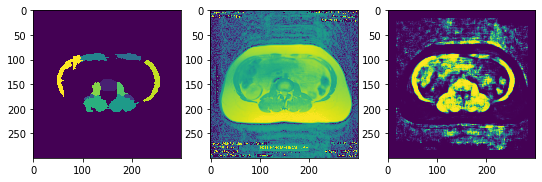

83
3 0
1 0


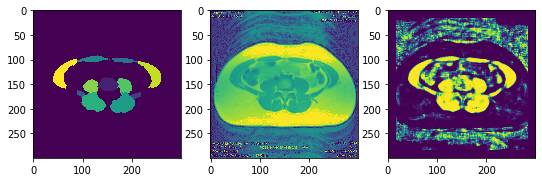

84
2 0
2 0


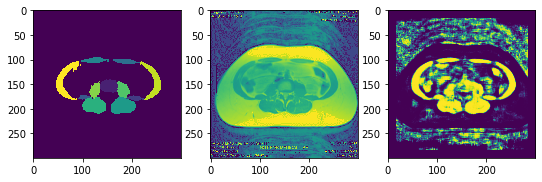

85
0 0
0 0


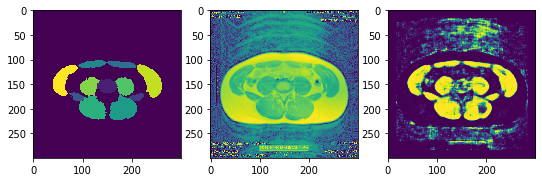

86
10 0
0 0


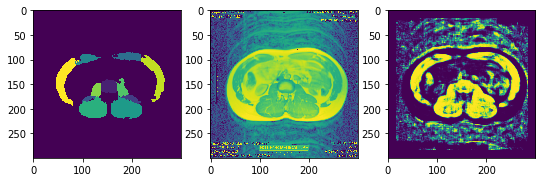

87
5 0
2 0


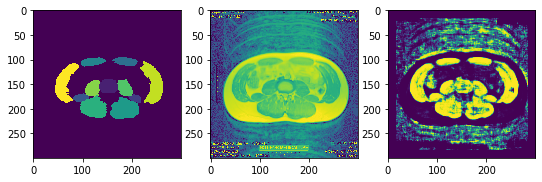

88
7 0
4 0


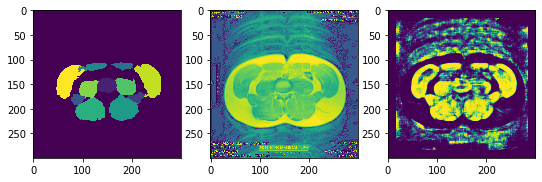

89
6 0
3 0


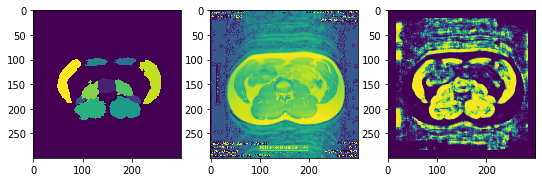

90
4 0
3 0


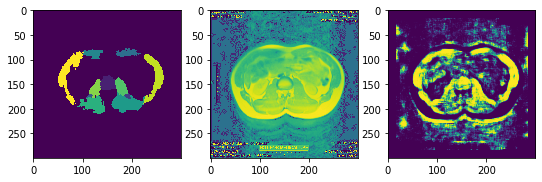

91
39 0
41 0


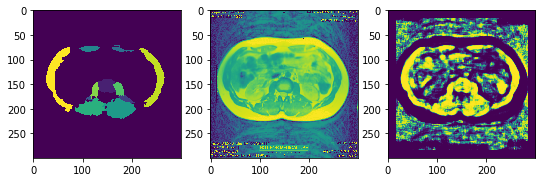

92
15 0


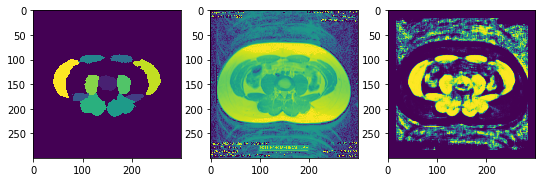

93
18 0
13 0


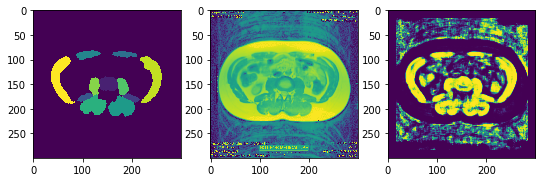

94
0 0
1 0


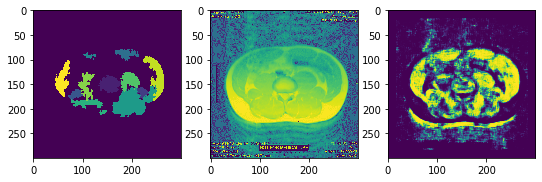

95
0 0
0 0


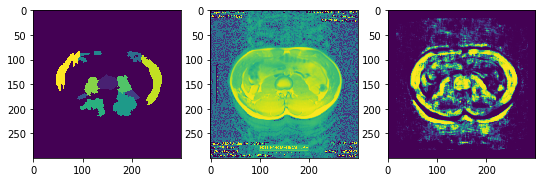

96
3 0
0 0


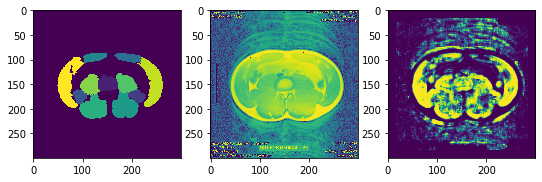

97
2 0
0 0


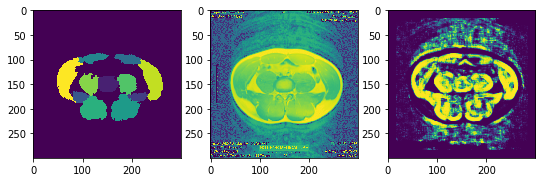

98
2 0
3 0
0 0


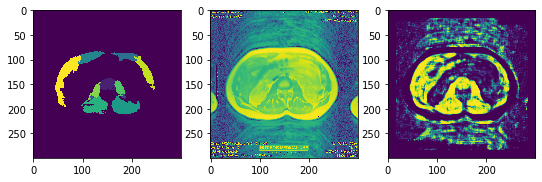

99
1 0


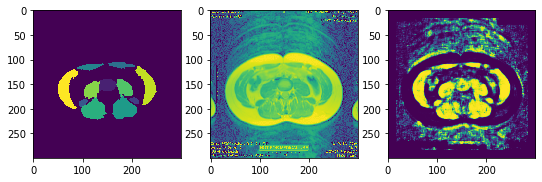

100
32 0


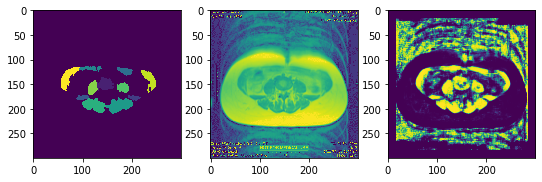

101
26 0


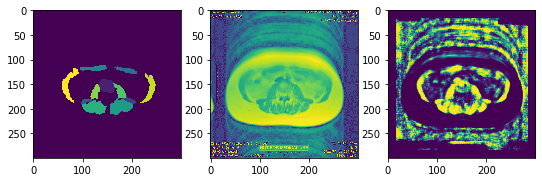

102
0 0
0 0


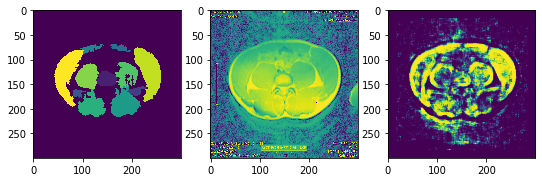

103
0 0
0 0
2 0


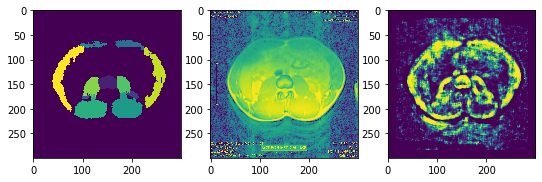

104
31 0
19 0


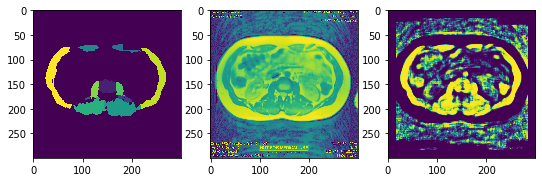

105
10 0
2 0


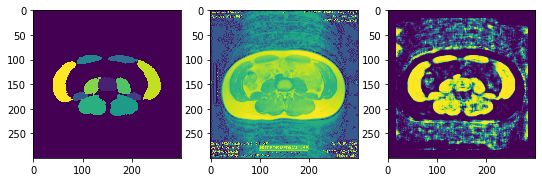

106
15 0
10 0


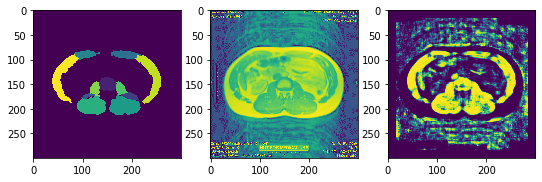

107
6 0
3 0


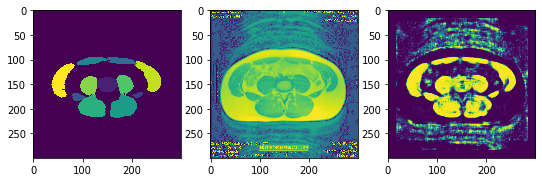

108
4 0
2 0


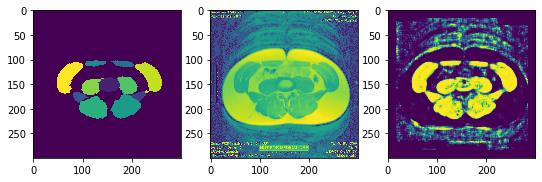

109
19 0
6 0


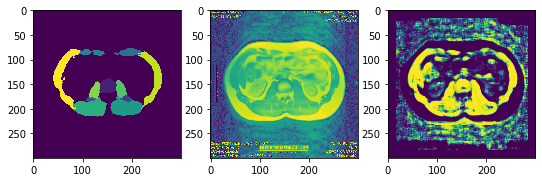

110
11 0
1 0


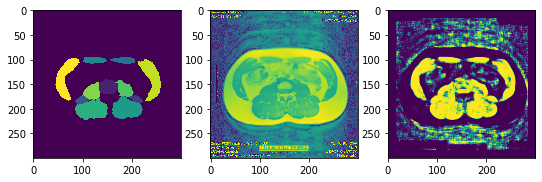

111
8 0
0 0


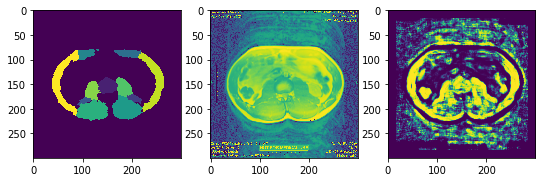

112
2 0
2 0


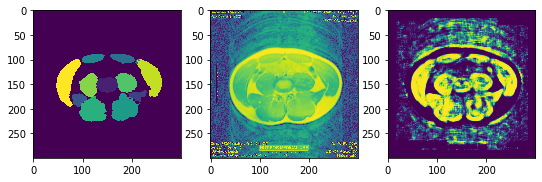

113
11 0
0 0


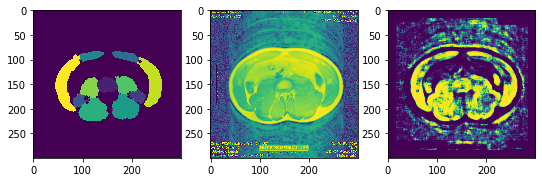

114
2 0
0 0


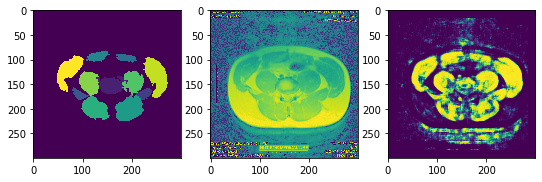

115
2 0
0 0


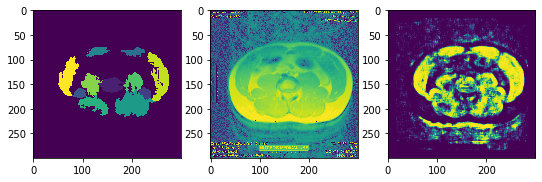

116
14 0
9 0


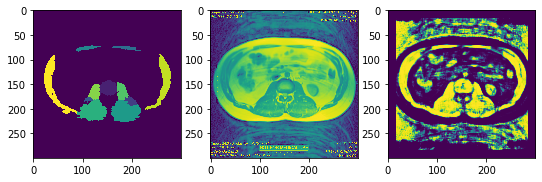

117
23 0
26 0


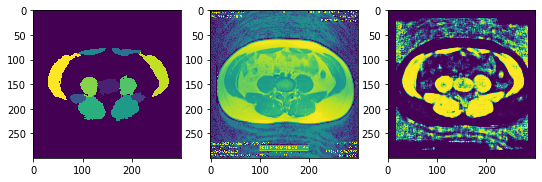

118
12 0
7 0


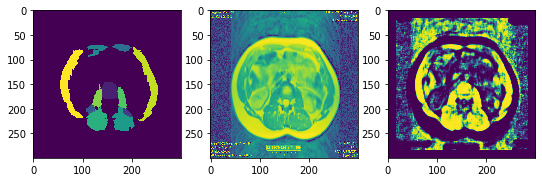

119
5 0
1 0


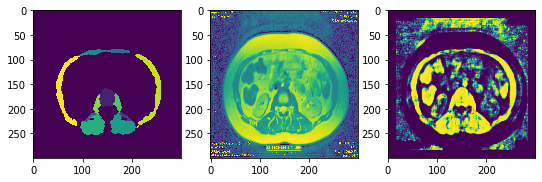

120
12 0
26 0


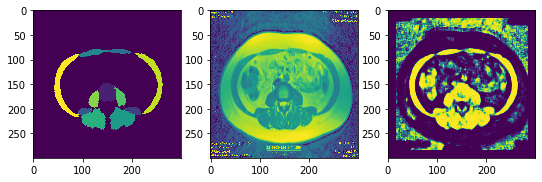

121
7 0


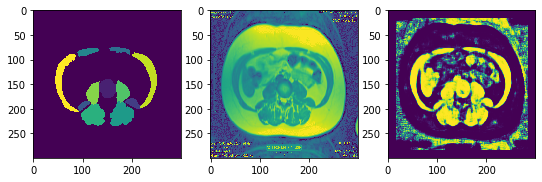

122
27 0
9 0


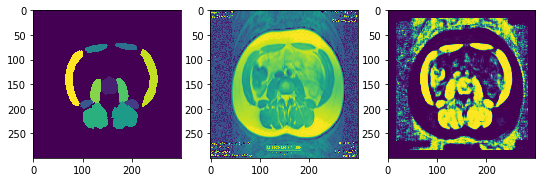

123
18 0
8 0


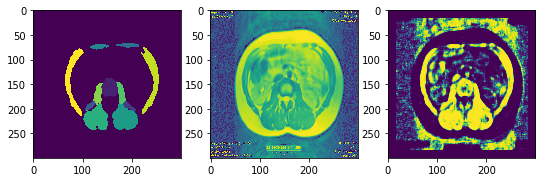

124
53 0
38 0


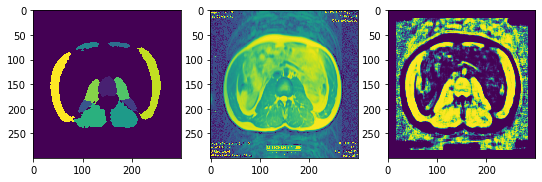

125
10 0
3 0


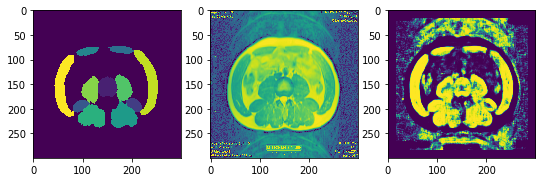

126
54 0
20 0


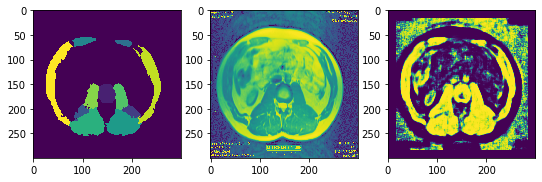

127
45 0
22 0


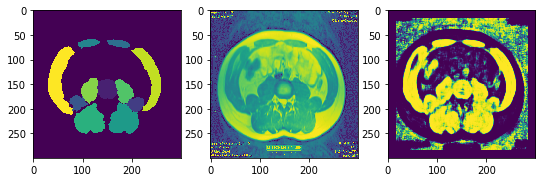

128
0 0
0 0


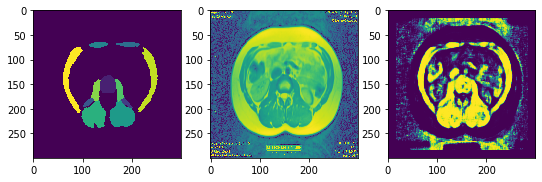

129
0 0


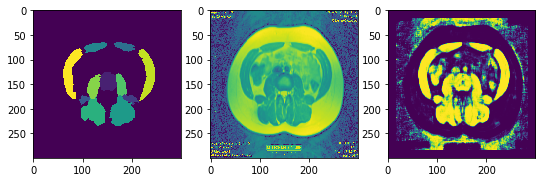

130
22 0
9 0


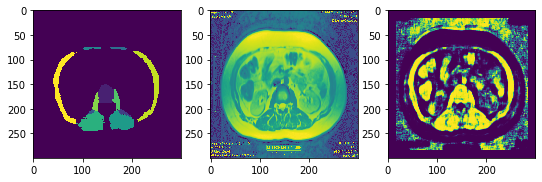

131
27 0
26 0


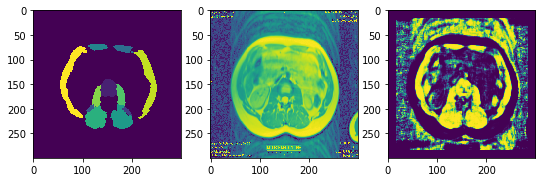

132
22 0


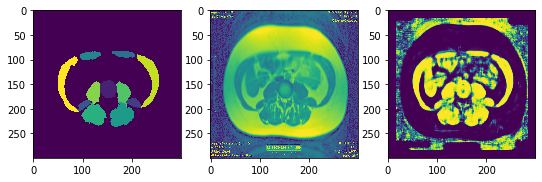

133
9 0
14 0


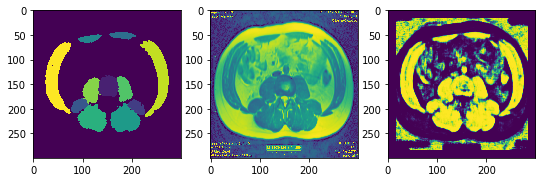

134
36 0
42 0


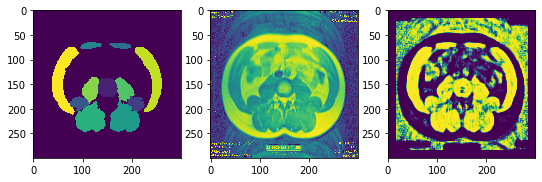

135
61 0
27 0


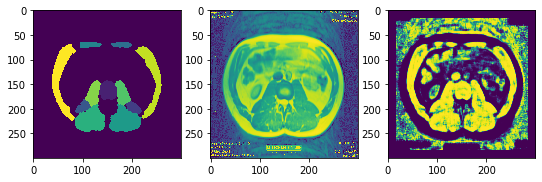

136
46 0
33 0
41 0


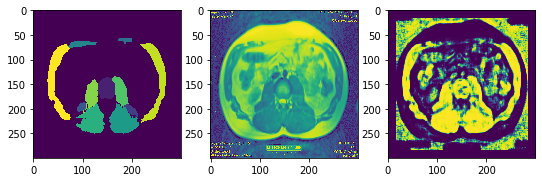

137
29 0
10 0


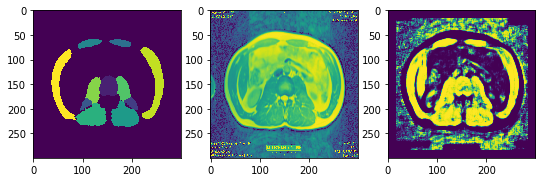

138
39 0
35 0


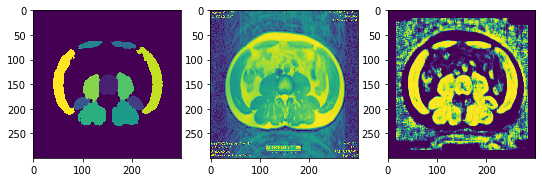

139
10 0
0 0


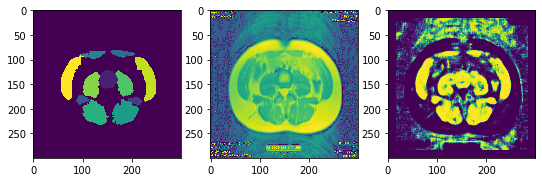

140
4 0
4 0


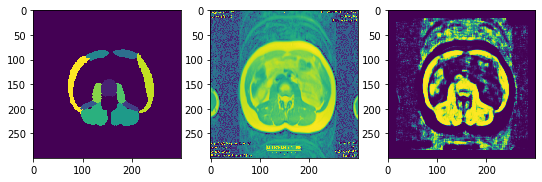

141
7 0
1 0


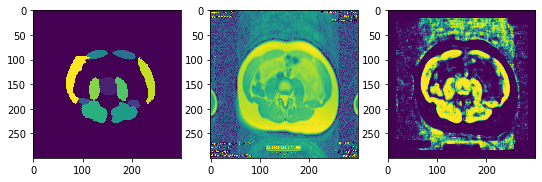

142
6 0
3 0


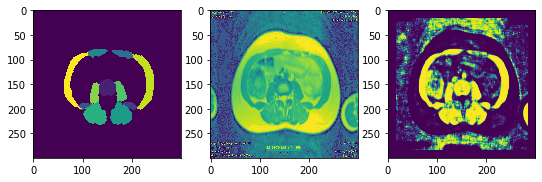

143
4 0
2 0


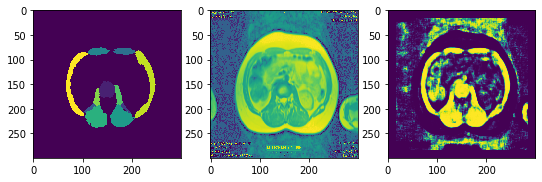

144
46 0


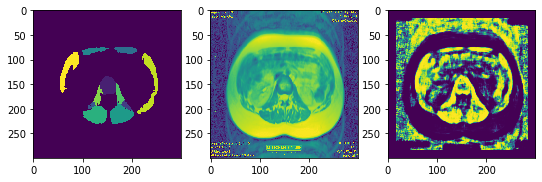

145
2 0
2 0


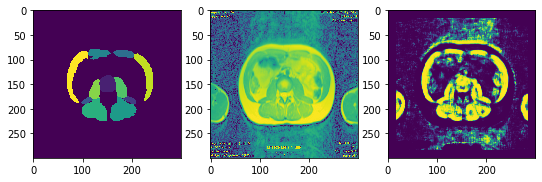

146
9 0


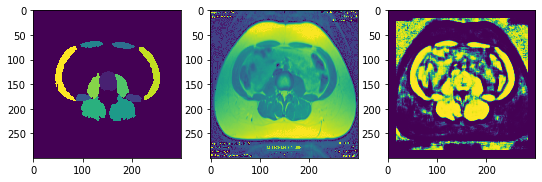

147
9 0


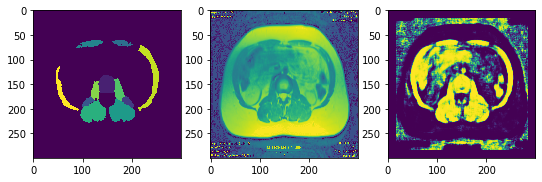

148
7 0
0 0


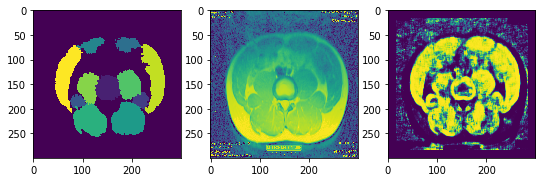

149
25 0
7 0


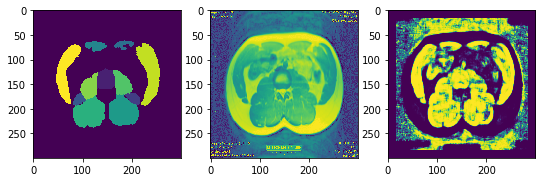

150
17 0
2 0


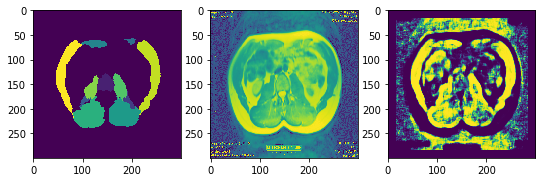

151
17 0
13 0


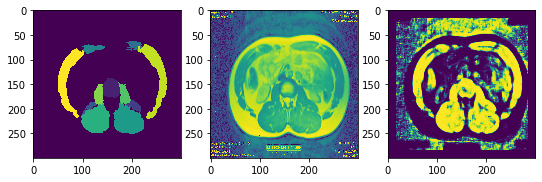

152
6 0
6 0


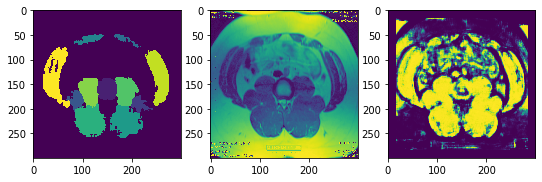

153
7 0
8 0


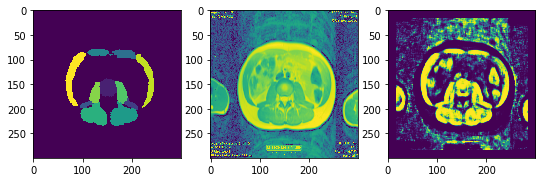

154
9 0


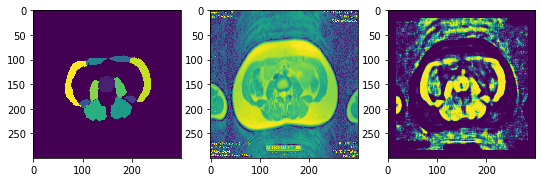

155
4 0
6 0


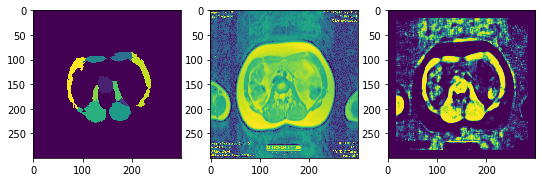

156
5 0


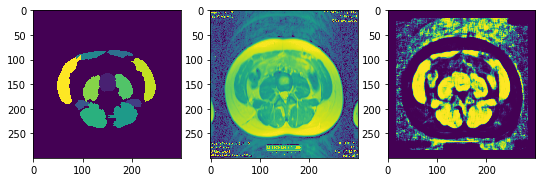

157
39 0


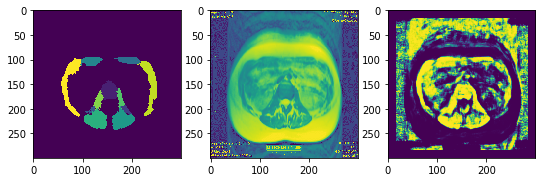

158
8 0


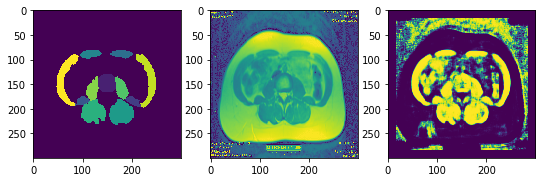

159
11 0


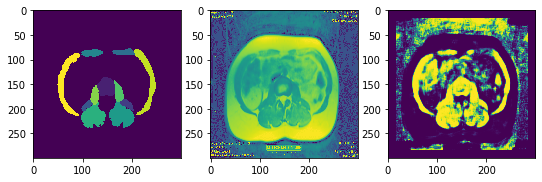

160
3 0
1 0


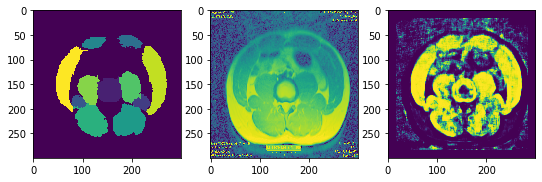

161
23 0
19 0


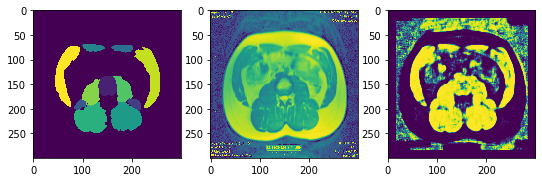

162
31 0
19 0


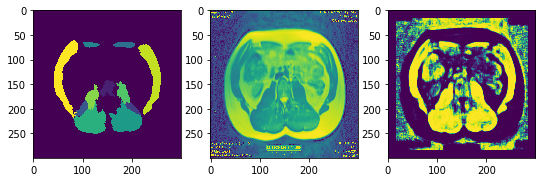

163
10 0
8 0


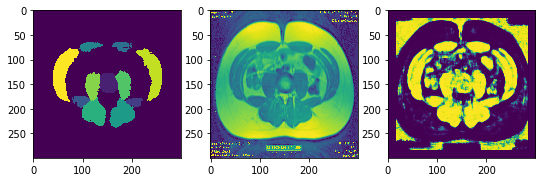

164
31 0
14 0


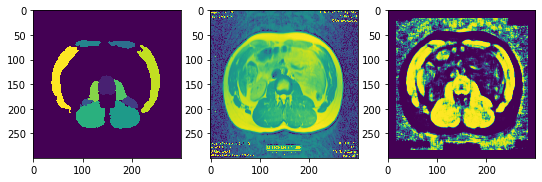

165
36 0
21 0
22 0


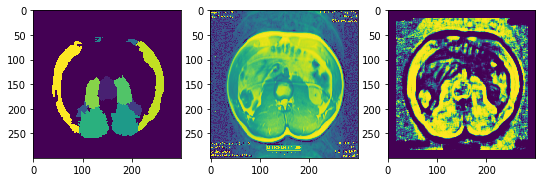

166
10 0
2 0


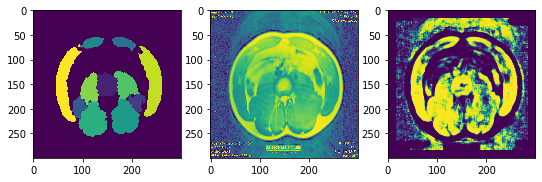

In [582]:
_n = np.random.randint(len(res3))
#_n = 91
res4 = []
for _n in range(len(X)):
    print(_n)
    _y = res3[_n][1]
    imt = np.zeros_like(_y)
    my_cnts = {}
    for _i in sorted(np.unique(_y.reshape(-1).astype('int')))[1:]:
        kern = np.ones((2, 2))
        kern2 = np.ones((1, 1))
        #_mardas = cv2.dilate(cv2.erode((_y==_i).astype('uint8'), kern, 2), kern2)
        _mardas = (_y==_i).astype('uint8')
        _, cnts, _ = cv2.findContours(_mardas.copy(),cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_NONE)
        cnts = sorted(cnts, key=lambda x: -len(x))
        my_cnts[_i] = cnts
        cv2.drawContours(imt, cnts, 0, int(_i), -1)

    _y1 = (imt == 10).astype('uint8')
    x, y = np.array(np.where(_y1)).max(axis=1)
    _y2 = (res3[_n][2] > .9).astype('uint8')
    _y2[:, :y-3] = 0
    _, cnts1, _ = cv2.findContours(_y2.copy(),cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_NONE)
    _, cnts2, _ = cv2.findContours(_y1.copy(),cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_NONE)
    tapas = []
    for i, cnt1 in enumerate(cnts1):
        for j, cnt2 in enumerate(cnts2):
            df1 = pd.DataFrame(cnt1.reshape(-1, 2))
            df2 = pd.DataFrame(cnt2.reshape(-1, 2))
            df3 = df1.merge(df2, on=[0, 1])
            if len(df1.merge(df2, on=[0, 1])):
                print(i, j)
                cv2.drawContours(imt, [cnt1], -1, 10, -1)
                cv2.drawContours(imt, [cnt2], -1, 10, -1)

    _y1 = (imt == 11).astype('uint8')
    x, y = np.array(np.where(_y1)).min(axis=1)
    _y2 = (res3[_n][2] > .9).astype('uint8')
    _y2[:, y+3:] = 0
    _, cnts1, _ = cv2.findContours(_y2.copy(),cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_NONE)
    _, cnts2, _ = cv2.findContours(_y1.copy(),cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_NONE)
    tapas = []
    for i, cnt1 in enumerate(cnts1):
        for j, cnt2 in enumerate(cnts2):
            df1 = pd.DataFrame(cnt1.reshape(-1, 2))
            df2 = pd.DataFrame(cnt2.reshape(-1, 2))
            df3 = df1.merge(df2, on=[0, 1])
            if len(df1.merge(df2, on=[0, 1])):
                print(i, j)
                cv2.drawContours(imt, [cnt1], -1, 11, -1)
                cv2.drawContours(imt, [cnt2], -1, 11, -1)

    res4.append(imt)
    fig, axes = plt.subplots(1, 3, figsize=(9, 3))
    axes[0].imshow(imt)
    axes[1].imshow(res3[_n][0])
    axes[2].imshow(res3[_n][2])
    plt.show()

1. 600 Characters abstract on my stuff
2. Report: All of Jonathan's work. One paragraph, no more than 6 lines, about the machine learning/image processing

Write the outline of one of these papers
1. What is the paper about
2. what are the experiments in the papers.

The focus in additive, extracting features and seeing which are more predictive

In [32]:
res5 = joblib.load('11_muscle_predictions_v03.pkl')

[autoreload of pkg_resources._vendor.six failed: Traceback (most recent call last):
  File "/home/bzr0014/anaconda3/envs/tensorGpu2/lib/python3.6/site-packages/IPython/extensions/autoreload.py", line 245, in check
    superreload(m, reload, self.old_objects)
  File "/home/bzr0014/anaconda3/envs/tensorGpu2/lib/python3.6/site-packages/IPython/extensions/autoreload.py", line 410, in superreload
    update_generic(old_obj, new_obj)
  File "/home/bzr0014/anaconda3/envs/tensorGpu2/lib/python3.6/site-packages/IPython/extensions/autoreload.py", line 347, in update_generic
    update(a, b)
  File "/home/bzr0014/anaconda3/envs/tensorGpu2/lib/python3.6/site-packages/IPython/extensions/autoreload.py", line 287, in update_class
    old_obj = getattr(old, key)
  File "/home/bzr0014/anaconda3/envs/tensorGpu2/lib/python3.6/site-packages/pkg_resources/_vendor/six.py", line 93, in __get__
    setattr(obj, self.name, result)  # Invokes __set__.
AttributeError: 'NoneType' object has no attribute 'cStringI

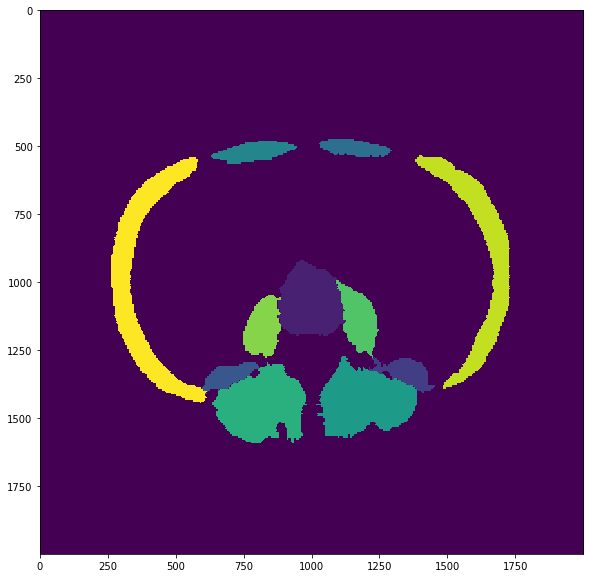

In [91]:
fig, ax = plt.subplots(1, 1, figsize=(10, 10))
_x = res5[10][-1]
new_shape = (2000, 2000)
imt = np.zeros(new_shape)
for i in sorted(np.unique(_x))[1:]:
    imt +=  (cv2.resize((_x==i).astype('uint8'), new_shape, cv2.INTER_AREA)>0).astype('uint8')*int(i)
ax.imshow(imt)

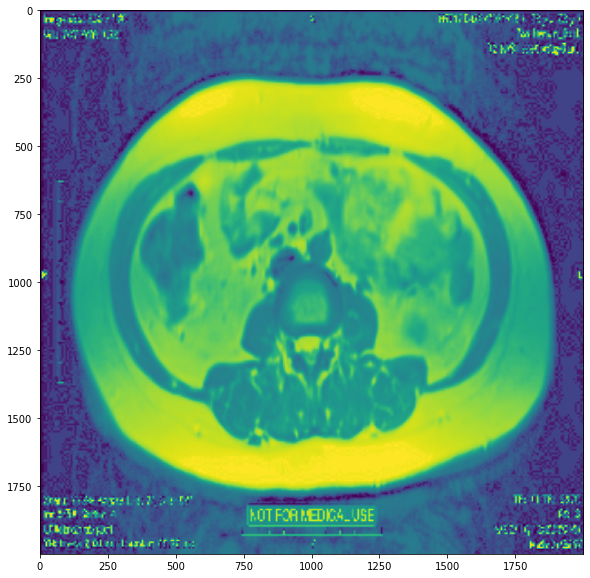

In [92]:
fig, ax = plt.subplots(1, 1, figsize=(10, 10))
_x = res5[10][0]
imt =  (cv2.resize(_x, new_shape, cv2.INTER_AREA))
plt.imshow(imt)

In [55]:
def enlarge(x, neigh_size):
    m = neigh_size//2
    m2 = neigh_size-m
    s = list(x.shape)
    s[0] += neigh_size
    s[1] += neigh_size
    z = np.zeros(tuple(s), dtype=x.dtype)
    z[m:-m2, m:-m2] = x
    return z

def get_neighbors(xy, neigh_size, padding=False, z=None, size=1000):
    if isinstance(xy, tuple):
        x, *y = xy
    else:
        x = xy
        y = tuple()
    if padding:
        x = enlarge(x, neigh_size)
        if len(y):
            y = enlarge(y, neigh_size)
    np.random.seed(random.randint(0, 1000))
    m = neigh_size//2
    m2 = neigh_size - m
    if z is None:
        z = np.zeros_like(x)
        z[:, m:-m2, m:-m2] = 1
    indices = np.array(np.where(z)).T
    print(indices.shape)
    f = list(range(len(indices)))
    X = np.array([x[i, j-m:j+m, k-m:k+m]
            for i, j, k, t in indices])
    if len(y):
        y = y[0]
        c = y.shape[-1]
        Y = np.array([y[i, j, k]
                for i, j, k, t in indices]).reshape(-1, c)
        return X, Y
    return X

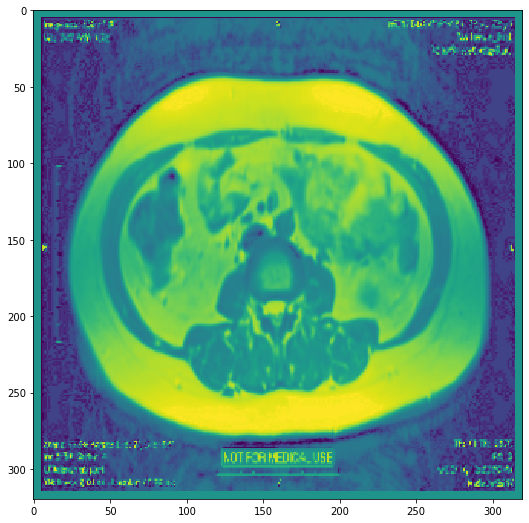

In [56]:
_x = cv2.resize(X[_n], (310, 310))
plt.imshow(enlarge(_x, 10))

In [57]:
m = load_model('best_so_far_neighbor_17_2020-04-13_17_23_17_464782.model_v03')
_n = 10
_x = X[_n]
#_y = cv2.resize(Y[_n], (310, 310))
_x = get_neighbors(_x.reshape(-1, *_x.shape), 17)
out = m.predict(_x)
shape = int(np.sqrt(out.shape[0]))
out = out.reshape(shape, shape)

(80089, 4)


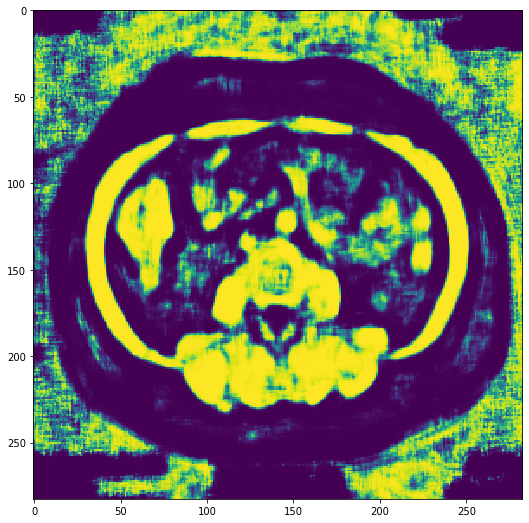

In [61]:
plt.imshow(out)

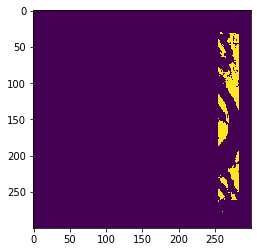

In [555]:
#_n = np.random.randint(len(X))

_y1 = (res3[_n][1] == 10).astype('uint8')
x, y = np.array(np.where(_y1)).max(axis=1)
_y2 = (res3[_n][2] > .9).astype('uint8')
_y2[:, :y-3] = 0

_, cnts1, _ = cv2.findContours(_y2.copy(),cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_NONE)
_, cnts2, _ = cv2.findContours(_y1.copy(),cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_NONE)

#_y2[np.where(_y1)] = 1
plt.imshow(_y2)

In [556]:
tapas = []
imt = np.zeros_like(_y1)
for i, cnt1 in enumerate(cnts1):
    for j, cnt2 in enumerate(cnts2):
        df1 = pd.DataFrame(cnt1.reshape(-1, 2))
        df2 = pd.DataFrame(cnt2.reshape(-1, 2))
        df3 = df1.merge(df2, on=[0, 1])
        if len(df1.merge(df2, on=[0, 1])):
            cv2.drawContours(imt, [cnt1], -1, 1, -1)
            cv2.drawContours(imt, [cnt2], -1, 1, -1)

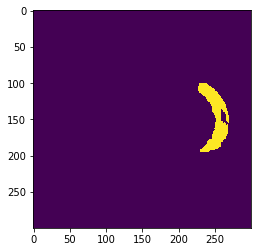

In [557]:
plt.imshow(imt)

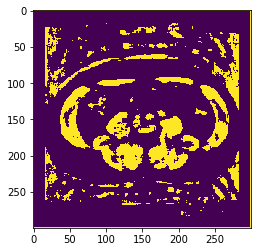

In [481]:
_y = (res3[_n][2]>.9).astype('uint8')
plt.imshow(cv2.floodFill(_y[1:-1, 1:-1], _y, (250, 110), 3)[2])

# Model v03

In [1]:
# Keras simple deep model:
def build_v03(width, height, depth, reg, init="he_normal"):
    # initialize the model along with the input shape to be
    # "channels last" and the channels dimension itself
    model = Sequential()
    inputShape = (height, width, depth)
    chanDim = -1

    # if we are using "channels first", update the input shape
    # and channels dimension
    if K.image_data_format() == "channels_first":
        inputShape = (depth, height, width)
        chanDim = 1
        
    # our first CONV layer will learn a total of 16 filters, each
    # Of which are 7x7 -- we'll then apply 2x2 strides to reduce
    # the spatial dimensions of the volume
    model.add(Conv2D(32, (5, 5), strides=(1, 1), padding="same",
        kernel_initializer=init,# kernel_regularizer=reg,
        input_shape=inputShape))
    model.add(Activation("relu"))
    model.add(BatchNormalization(axis=chanDim))
   
    model.add(Conv2D(32, (15, 15), strides=(1, 1), padding="same",
        kernel_initializer=init,# kernel_regularizer=reg,
        input_shape=inputShape))
    model.add(Activation("relu"))
    model.add(BatchNormalization(axis=chanDim))

    # here we stack two CONV layers on top of each other where
    # each layerswill learn a total of 32 (3x3) filters
    model.add(Conv2D(32, (20, 20), padding="same",
        kernel_initializer=init, #kernel_regularizer=reg)
                    ))
    model.add(Activation("relu"))
    model.add(BatchNormalization(axis=chanDim))
    #model.add(Activation("relu"))
    #model.add(BatchNormalization(axis=chanDim))
    model.add(Conv2D(32, (30, 30), strides=(1, 1), padding="same",
        kernel_initializer=init, #kernel_regularizer=reg)
                    ))
    model.add(Activation("relu"))
    model.add(BatchNormalization(axis=chanDim))
    #model.add(Activation("relu"))
    #model.add(BatchNormalization(axis=chanDim))
    #model.add(Dropout(0.25))
    # stack two more CONV layers, keeping the size of each filter
    # as 3x3 but increasing to 64 total learned filters
    #model.add(Conv2D(64, (3, 3), padding="same",
    #    kernel_initializer=init, kernel_regularizer=reg))
    #model.add(Activation("relu"))
    ##model.add(BatchNormalization(axis=chanDim))
    #model.add(Conv2D(64, (3, 3), strides=(1, 1), padding="same",
    #    kernel_initializer=init, kernel_regularizer=reg))
    #model.add(Activation("relu"))
    ##model.add(BatchNormalization(axis=chanDim))
    #model.add(Dropout(0.25))
#
    ## increase the number of filters again, this time to 128
    #model.add(Conv2D(128, (3, 3), padding="same",
    #    kernel_initializer=init, kernel_regularizer=reg))
    #model.add(Activation("relu"))
    ##model.add(BatchNormalization(axis=chanDim))
    model.add(Conv2D(10, (3, 3), strides=(1, 1), padding="same",
        kernel_initializer=init,  #kernel_regularizer=reg
                    )
             )
    model.add(Activation("relu"))
    model.add(BatchNormalization(axis=chanDim))
    model.add(Conv2D(12, (3, 3), strides=(1, 1), padding="same",
        kernel_initializer=init, #kernel_regularizer=reg)
                    ))
    #model.add(Activation("relu"))
    #model.add(Flatten())
    #model.add(Dense(100))
    #model.add(Dense(10))
    #model.add(Dense(1))
    model.add(Activation("sigmoid"))
    #model.add(BatchNormalization(axis=chanDim))
    return model

In [2]:
from keras import losses
from sklearn.preprocessing import OneHotEncoder
encoder = OneHotEncoder()
opt = Adam(lr=1e-4)#, decay=1e-4 / epochs)
X = np.array([[x[0] for x in XYZ]]).reshape(-1, 300, 300, 1)
X = (X-X.mean())/X.std()
Y = encoder.fit_transform(np.array([[x[1] for x in XYZ]]).reshape(-1, 1)).toarray().reshape(-1, 300, 300, 12)
model = build_v03(width=300, height=300, depth=1, reg=None)
model.compile(loss=losses.categorical_crossentropy, optimizer=opt, metrics=["accuracy"])

Using TensorFlow backend.
/home/bzr0014/anaconda3/envs/tensorGpu2/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:458: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/home/bzr0014/anaconda3/envs/tensorGpu2/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:459: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/home/bzr0014/anaconda3/envs/tensorGpu2/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:460: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/home

NameError: name 'Adam' is not defined

In [13]:
model.fit(X, Y, batch_size=10, epochs=100)

Epoch 1/100
100/167 [================>.............] - ETA: 50s - loss: 2.5135 - acc: 0.1913 

KeyboardInterrupt: 

In [95]:
ls model*

model_11muscles_41_v01.model  model_11muscles_v01.data   model_v01.pkl
model_11muscles_82_v01.model  model_11muscles_v01.model  model_v02.pkl

models:
180728-1035S/  180906-150451/


In [96]:
out = joblib.load('model_11muscles_v01.data')

In [107]:
out[2].shape

(125, 300, 300, 1, 12)

In [1]:
import tensorflow as tf
#import keras

KeyError: "Couldn't find field google.protobuf.FieldDescriptorProto.proto3_optional"

In [2]:
base_model = keras.applications.MobileNetV2(input_shape=[224, 224, 3], include_top=False)

In [3]:
# Use the activations of these layers
layer_names = [
    'block_1_expand_relu',   # 64x64
    'block_3_expand_relu',   # 32x32
    'block_6_expand_relu',   # 16x16
    'block_13_expand_relu',  # 8x8
    'block_16_project',      # 4x4
]
layers = [base_model.get_layer(name).output for name in layer_names]

# Create the feature extraction model
down_stack = keras.Model(inputs=base_model.input, outputs=layers)

down_stack.trainable = False

In [6]:
from tensorflow_examples.models.pix2pix import pix2pix

AttributeError: module 'tensorflow' has no attribute 'data'

In [8]:
up_stack = [
    pix2pix.upsample(512, 3),  # 4x4 -> 8x8
    pix2pix.upsample(256, 3),  # 8x8 -> 16x16
    pix2pix.upsample(128, 3),  # 16x16 -> 32x32
    pix2pix.upsample(64, 3),   # 32x32 -> 64x64
]

NameError: name 'pix2pix' is not defined